# Clone 'DeepPrior' GitHub Repo

In [ ]:
"""
*Uncomment if running on colab* 
Set Runtime -> Change runtime type -> Under Hardware Accelerator select GPU in Google Colab 
"""
!git clone https://github.com/DmitryUlyanov/deep-image-prior
!mv deep-image-prior/* ./

Cloning into 'deep-image-prior'...
remote: Enumerating objects: 289, done.
remote: Total 289 (delta 0), reused 0 (delta 0), pack-reused 289
Receiving objects: 100% (289/289), 24.28 MiB | 17.71 MiB/s, done.
Resolving deltas: 100% (155/155), done.


# Import Dataset

In [ ]:
# let's try with MOBIPHONE dataset
!wget --no-check-certificate -r "https://drive.google.com/uc?export=download&id=1MflXkdaeAFyBftKkCTTuUXkfJ-fOTzus" -O "MOBIPHONE.zip"
!unzip MOBIPHONE.zip

#THEN WE WILL NEED TO RUN THE MAIN SCRIPT OVER ALL OF THE FILES IN THE DATASET

test_folder = "MOBIPHONE/Vodafone joy 845/"

will be placed in the single file you specified.

--2021-05-22 09:16:14--  https://drive.google.com/uc?export=download&id=1MflXkdaeAFyBftKkCTTuUXkfJ-fOTzus
Resolving drive.google.com (drive.google.com)... 173.194.76.139, 173.194.76.101, 173.194.76.113, ...
Connecting to drive.google.com (drive.google.com)|173.194.76.139|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/html]
Saving to: ‘MOBIPHONE.zip’

MOBIPHONE.zip           [ <=>                ]   3.19K  --.-KB/s    in 0s      

2021-05-22 09:16:14 (42.5 MB/s) - ‘MOBIPHONE.zip’ saved [3271]

Loading robots.txt; please ignore errors.
--2021-05-22 09:16:14--  https://drive.google.com/robots.txt
Reusing existing connection to drive.google.com:443.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/plain]
Saving to: ‘MOBIPHONE.zip’

MOBIPHONE.zip           [ <=>                ]     570  --.-KB/s    in 0s      

2021-05-22 09:16:14 (76.0 MB/s) - ‘MOBIPHONE.zip’ saved [570]


# Import Libraries

In [ ]:
from PIL import Image
import librosa
from skimage.restoration import inpaint
from scipy.io import wavfile
from __future__ import print_function
import matplotlib.pyplot as plt
import csv
import os
from google.colab import files

%matplotlib inline

import os
# os.environ['CUDA_VISIBLE_DEVICES'] = '1'

import numpy as np
from models.resnet import ResNet
from models.unet import UNet
from models.skip import skip
import torch
import torch.optim

from utils.inpainting_utils import *

torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark =True
dtype = torch.cuda.FloatTensor

PLOT = False 
imsize = -1
dim_div_by = 64

# Functions

In [ ]:
#functions
index = 0
def closure():
    
    global index
    
    if param_noise:
        for n in [x for x in net.parameters() if len(x.size()) == 4]:
            n = n + n.detach().clone().normal_() * n.std() / 50
    
    net_input = net_input_saved
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
        
        
    out = net(net_input)
   
    total_loss = mse(out * mask_var, img_var * mask_var)
    total_loss.backward()
        
    print ('Iteration %05d    Loss %f' % (index, total_loss.item()), '\r', end='')
    if  PLOT and index % show_every == 0:
        out_np = torch_to_np(out)
        #plot_image_grid([np.clip(out_np, 0, 1)], factor=figsize, nrow=1)
        plt.figure()
        plt.imshow(np.clip(out_np, 0, 1)[0,:,:], cmap='gray')
        plt.show()

    index += 1

    return total_loss


def convert(freq_img, ph, data, reconstruction, max_val, min_val, sr):
  inpainted_freq_rep_db = ((freq_img-0)/(255-0))*(max_val-min_val)+min_val
  inpainted_freq_rep = librosa.db_to_amplitude(inpainted_freq_rep_db)

  if data == "1": #stft
    if reconstruction == "1": #original phase
      #inpainted_freq_rep = librosa.db_to_amplitude(inpainted_freq_rep_db)
      real = inpainted_freq_rep * np.cos(ph)
      imag = inpainted_freq_rep * np.sin(ph)
      mod_freq_rep = np.zeros([len(real), len(real[0])], dtype=np.complex_)
      # inverse transform (creating a complex stft from modified magnitude and original phase)
      for i in range(len(real)):
        for j in range(len(real[0])):
          mod_freq_rep[i, j] = complex(real[i, j], imag[i, j])
          
      output = librosa.istft(mod_freq_rep, win_length=625, hop_length=625, window='rect')

    else: #griffinlim
      #inpainted_freq_rep = librosa.db_to_amplitude(inpainted_freq_rep_db)
      output = librosa.griffinlim(inpainted_freq_rep, win_length=625, hop_length=625, window='rect')

  else: #log mel
    if reconstruction == "1": #original phase
      #inpainted_freq_rep = librosa.db_to_power(inpainted_freq_rep_db)
      inpainted_freq_rep = librosa.feature.inverse.mel_to_stft(inpainted_freq_rep, sr, n_fft=1023, power=1.0)
      real = inpainted_freq_rep * np.cos(ph)
      imag = inpainted_freq_rep * np.sin(ph)
      mod_freq_rep = np.zeros([len(real), len(real[0])], dtype=np.complex_)
      # inverse transform (creating a complex stft from modified magnitude and original phase)
      for i in range(len(real)):
        for j in range(len(real[0])):
          mod_freq_rep[i, j] = complex(real[i, j], imag[i, j])
        
      output = librosa.istft(mod_freq_rep, win_length=625, hop_length=625, window='rect')
      
    else: #griffinlim
      #inpainted_freq_rep = librosa.db_to_power(inpainted_freq_rep_db)
      mod_freq_rep = librosa.feature.inverse.mel_to_stft(inpainted_freq_rep, sr, n_fft=1023,power=1.0)
      output = librosa.griffinlim(mod_freq_rep, win_length=625, hop_length=625, window='rect')
    

  return output


from math import log10, sqrt

def wada_snr(wav):
    # Direct blind estimation of the SNR of a speech signal.
    #
    # Paper on WADA SNR:
    #   http://www.cs.cmu.edu/~robust/Papers/KimSternIS08.pdf
    #
    # This function was adapted from this matlab code:
    #   https://labrosa.ee.columbia.edu/projects/snreval/#9
    #
    # MIT license, John Meade, 2020

    # init
    eps = 1e-10
    # next 2 lines define a fancy curve derived from a gamma distribution -- see paper
    db_vals = np.arange(-20, 101)
    g_vals = np.array([0.40974774, 0.40986926, 0.40998566, 0.40969089, 0.40986186, 0.40999006, 0.41027138, 0.41052627, 0.41101024, 0.41143264, 0.41231718, 0.41337272, 0.41526426, 0.4178192 , 0.42077252, 0.42452799, 0.42918886, 0.43510373, 0.44234195, 0.45161485, 0.46221153, 0.47491647, 0.48883809, 0.50509236, 0.52353709, 0.54372088, 0.56532427, 0.58847532, 0.61346212, 0.63954496, 0.66750818, 0.69583724, 0.72454762, 0.75414799, 0.78323148, 0.81240985, 0.84219775, 0.87166406, 0.90030504, 0.92880418, 0.95655449, 0.9835349 , 1.01047155, 1.0362095 , 1.06136425, 1.08579312, 1.1094819 , 1.13277995, 1.15472826, 1.17627308, 1.19703503, 1.21671694, 1.23535898, 1.25364313, 1.27103891, 1.28718029, 1.30302865, 1.31839527, 1.33294817, 1.34700935, 1.3605727 , 1.37345513, 1.38577122, 1.39733504, 1.40856397, 1.41959619, 1.42983624, 1.43958467, 1.44902176, 1.45804831, 1.46669568, 1.47486938, 1.48269965, 1.49034339, 1.49748214, 1.50435106, 1.51076426, 1.51698915, 1.5229097 , 1.528578  , 1.53389835, 1.5391211 , 1.5439065 , 1.54858517, 1.55310776, 1.55744391, 1.56164927, 1.56566348, 1.56938671, 1.57307767, 1.57654764, 1.57980083, 1.58304129, 1.58602496, 1.58880681, 1.59162477, 1.5941969 , 1.59693155, 1.599446  , 1.60185011, 1.60408668, 1.60627134, 1.60826199, 1.61004547, 1.61192472, 1.61369656, 1.61534074, 1.61688905, 1.61838916, 1.61985374, 1.62135878, 1.62268119, 1.62390423, 1.62513143, 1.62632463, 1.6274027 , 1.62842767, 1.62945532, 1.6303307 , 1.63128026, 1.63204102])

    # peak normalize, get magnitude, clip lower bound
    wav = np.array(wav)
    wav = wav / np.max(np.abs(wav))
    abs_wav = np.abs(wav)
    abs_wav[abs_wav < eps] = eps

    # calcuate statistics
    # E[|z|]
    v1 = max(eps, abs_wav.mean())
    # E[log|z|]
    v2 = np.log(abs_wav).mean()
    # log(E[|z|]) - E[log(|z|)]
    v3 = np.log(v1) - v2

    # table interpolation
    wav_snr_idx = None
    if any(g_vals < v3):
        wav_snr_idx = np.where(g_vals < v3)[0].max()
    # handle edge cases or interpolate
    if wav_snr_idx is None:
        wav_snr = db_vals[0]
    elif wav_snr_idx == len(db_vals) - 1:
        wav_snr = db_vals[-1]
    else:
        wav_snr = db_vals[wav_snr_idx] + \
            (v3-g_vals[wav_snr_idx]) / (g_vals[wav_snr_idx+1] - \
            g_vals[wav_snr_idx]) * (db_vals[wav_snr_idx+1] - db_vals[wav_snr_idx])

    # Calculate SNR
    dEng = sum(wav**2)
    dFactor = 10**(wav_snr / 10)
    dNoiseEng = dEng / (1 + dFactor) # Noise energy
    dSigEng = dEng * dFactor / (1 + dFactor) # Signal energy
    snr = 10 * np.log10(dSigEng / dNoiseEng)

    return snr

def PSNR(original, compressed):
  mse = np.mean((original - compressed) ** 2)
  if mse == 0:  # MSE is zero means no noise is present in the signal .
  # Therefore PSNR have no importance.
    return 100
  max_pixel = 255.0
  psnr = 20 * log10(max_pixel / sqrt(mse))
  return psnr

def alternative_SNR(y):

  def energy(x):
    e = np.sum(x ** 2)
    return e

  Z = librosa.stft(y, n_fft=1023, win_length=625, hop_length=625, window='rect')
  z = librosa.istft(Z, win_length=625, hop_length=625, window='rect')
  n = y[:z.size] - z
  snr = 10 * np.log10(energy(y)/energy(n))
  return snr


# Main Program

In [ ]:
!pip install pesq

  Created wheel for pesq: filename=pesq-0.0.2-cp37-cp37m-linux_x86_64.whl size=160886 sha256=51fce0300ac046de2372882307bc818963726d24018b4154b1bd0cf1dec5784c
  Stored in directory: /root/.cache/pip/wheels/95/96/02/64c5b0ffb69c5651438f511679983a6ed3ef23873d2e9ecde4
Successfully built pesq


1-STFT / 2-LOG MEL SPECT
2
1-Original Phase / 2-Griffinlim
2


/usr/local/lib/python3.7/dist-packages/librosa/filters.py:239: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  "Empty filters detected in mel frequency basis. "



 ITERATION 1 - FILE 1...


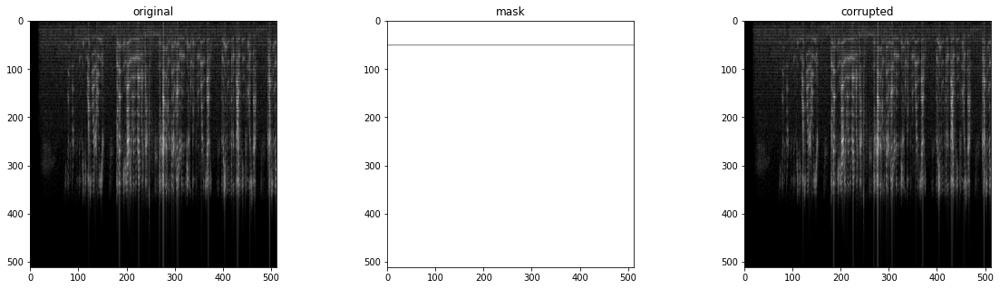

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 1 OUTPUT:



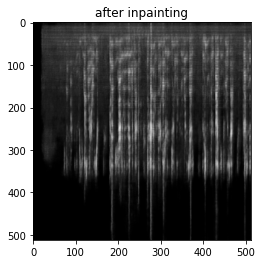


 ITERATION 1 - FILE 2...


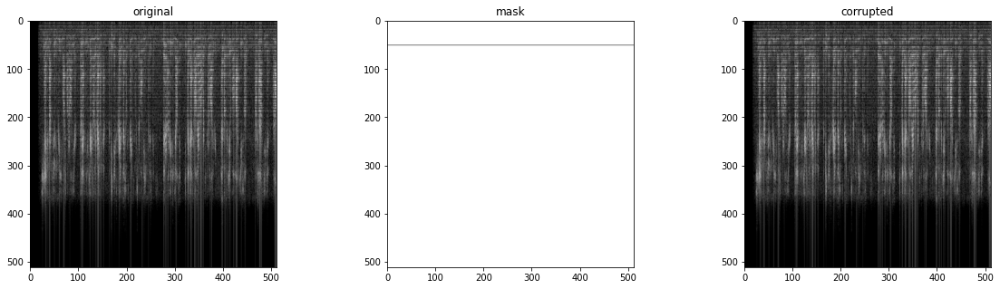

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 2 OUTPUT:



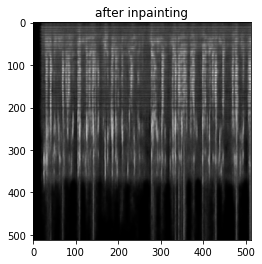


 ITERATION 1 - FILE 3...


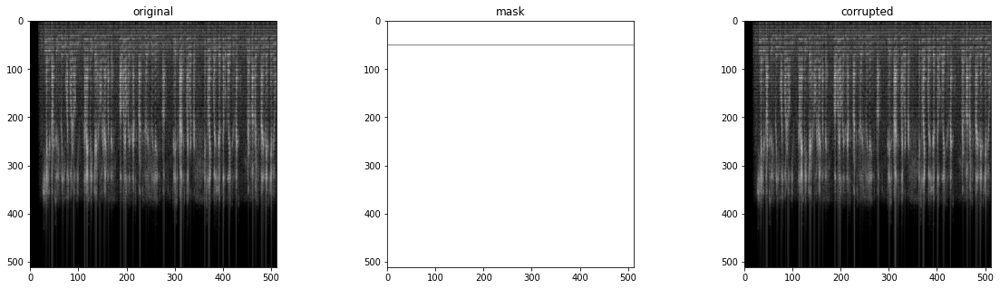

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 3 OUTPUT:



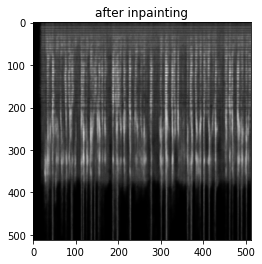


 ITERATION 1 - FILE 4...


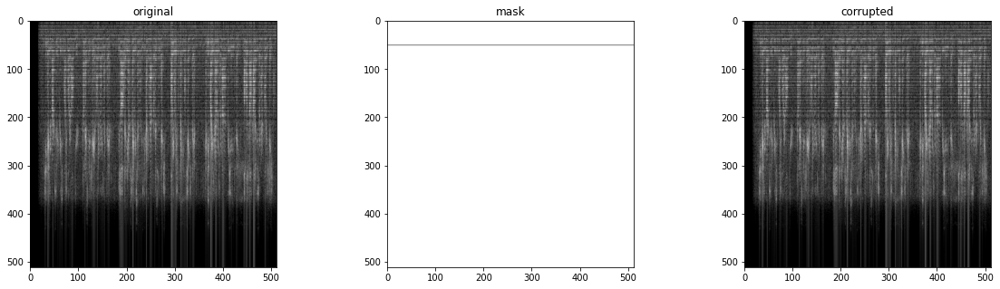

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 4 OUTPUT:



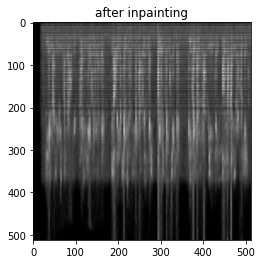


 ITERATION 1 - FILE 5...


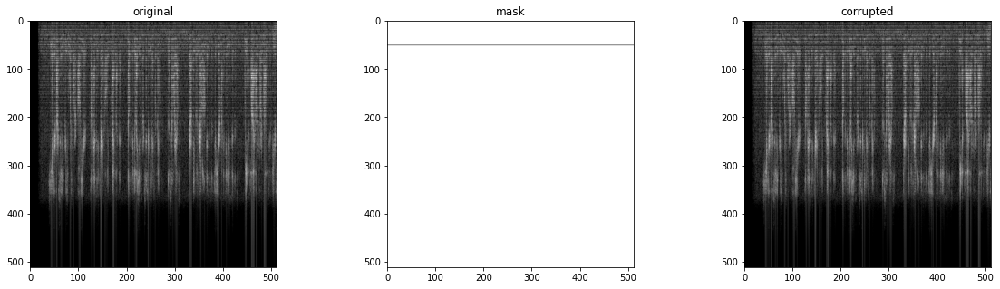

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 5 OUTPUT:



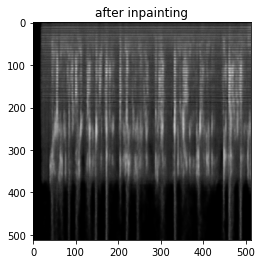


 ITERATION 1 - FILE 6...


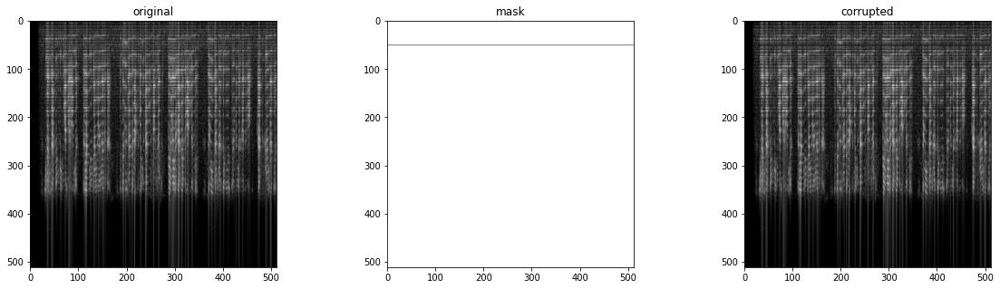

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 6 OUTPUT:



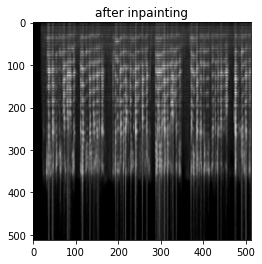


 ITERATION 1 - FILE 7...


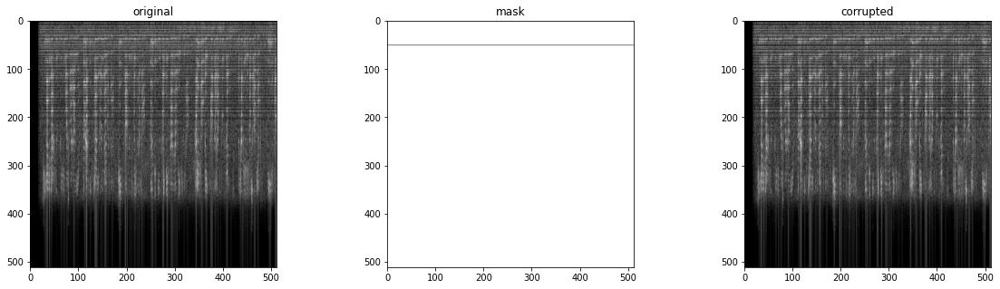

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 7 OUTPUT:



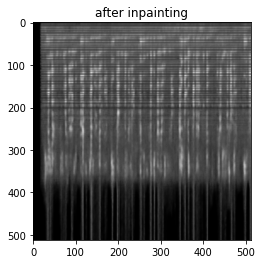


 ITERATION 1 - FILE 8...


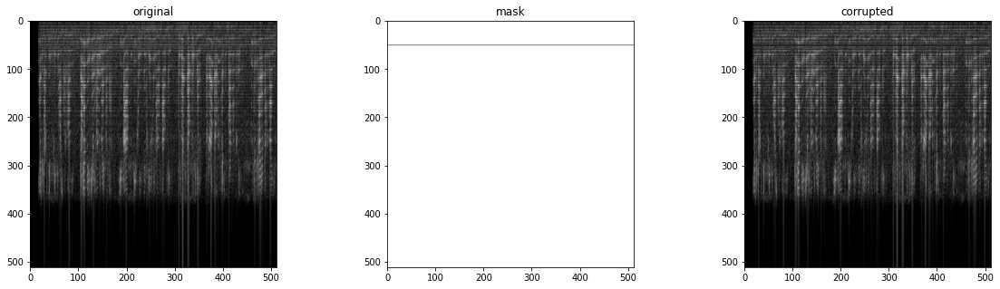

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 8 OUTPUT:



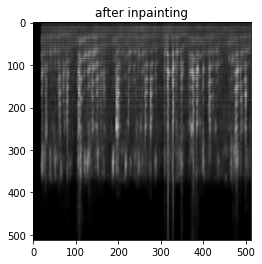


 ITERATION 1 - FILE 9...


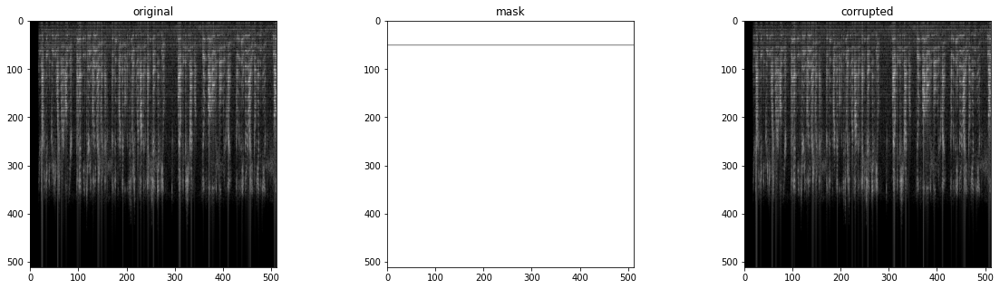

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 9 OUTPUT:



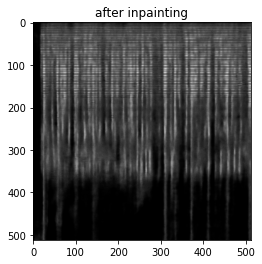


 ITERATION 1 - FILE 10...


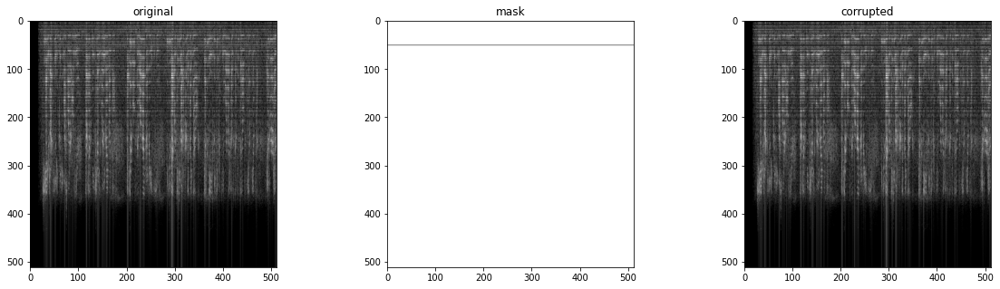

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 10 OUTPUT:



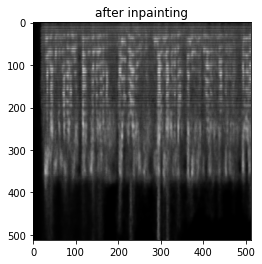


 ITERATION 1 - FILE 11...


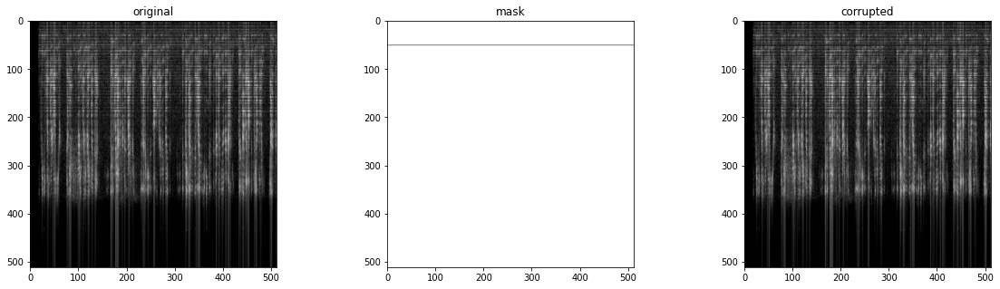

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 11 OUTPUT:



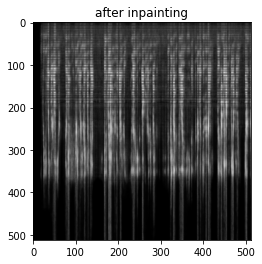


 ITERATION 1 - FILE 12...


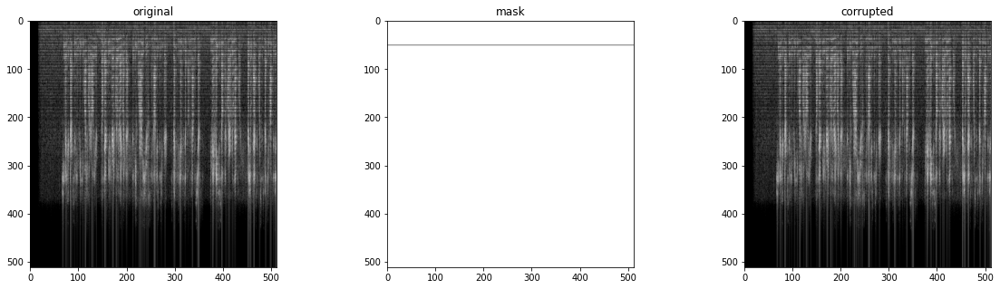

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 12 OUTPUT:



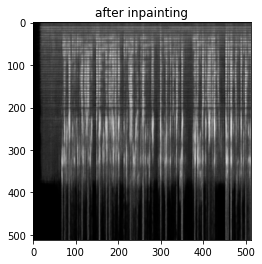


 ITERATION 1 - FILE 13...


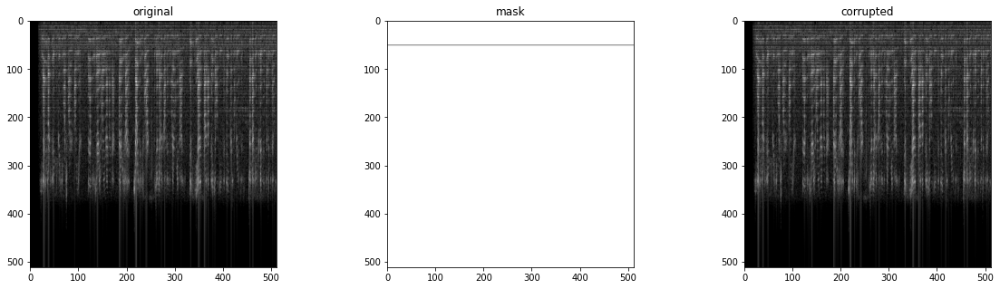

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 13 OUTPUT:



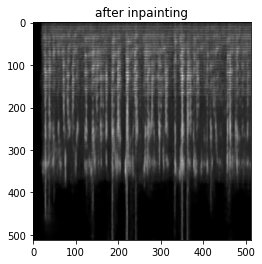


 ITERATION 1 - FILE 14...


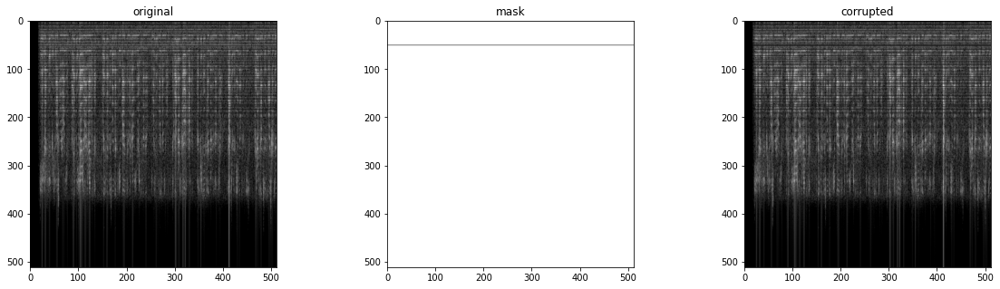

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 14 OUTPUT:



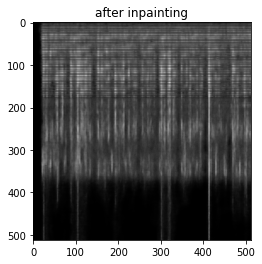


 ITERATION 1 - FILE 15...


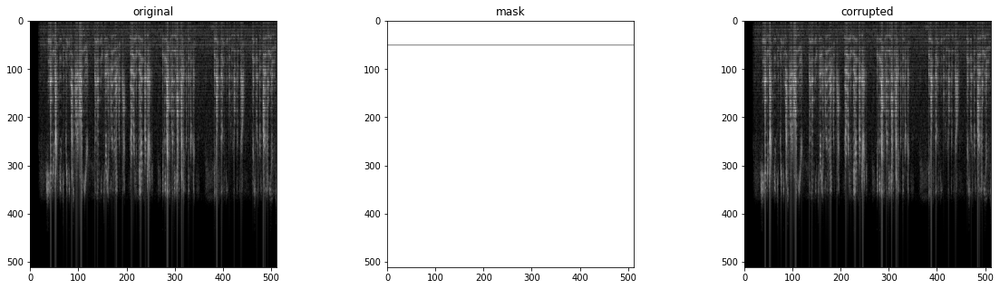

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 15 OUTPUT:



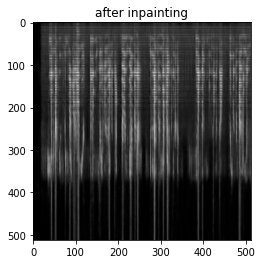


 ITERATION 1 - FILE 16...


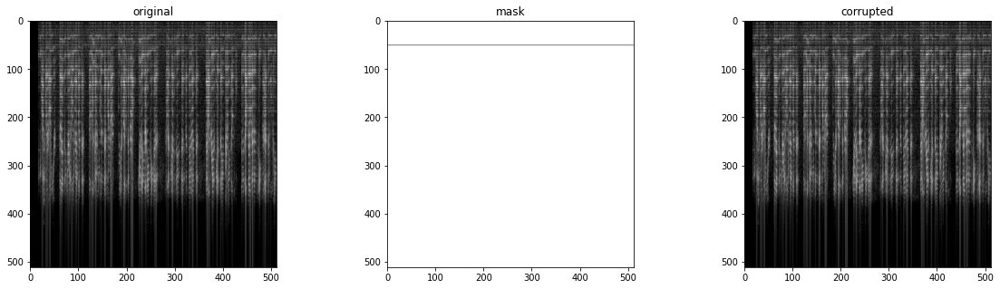

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 16 OUTPUT:



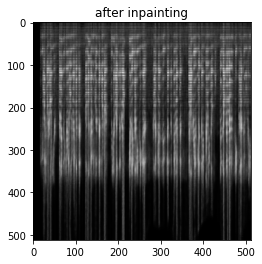


 ITERATION 1 - FILE 17...


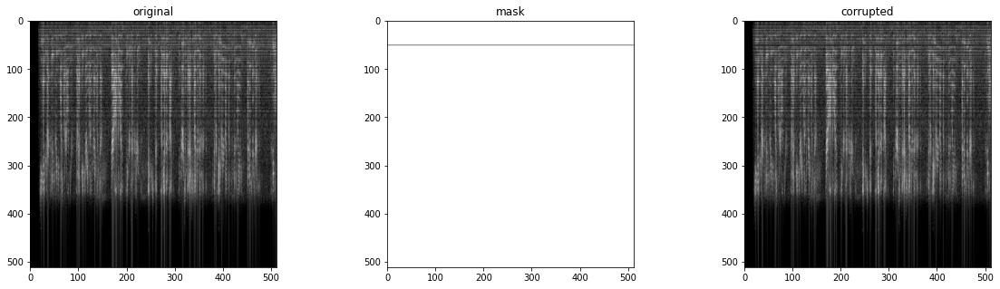

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 17 OUTPUT:



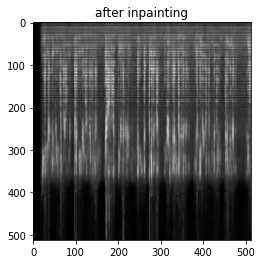


 ITERATION 1 - FILE 18...


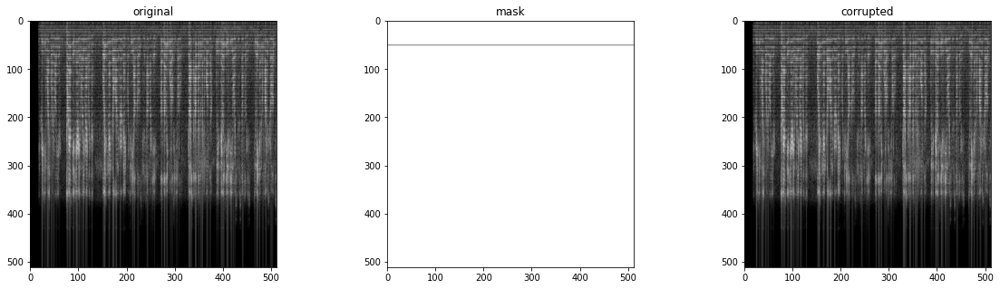

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 18 OUTPUT:



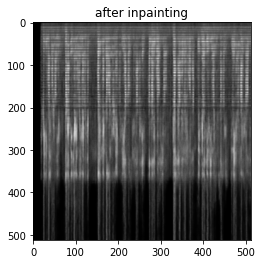


 ITERATION 1 - FILE 19...


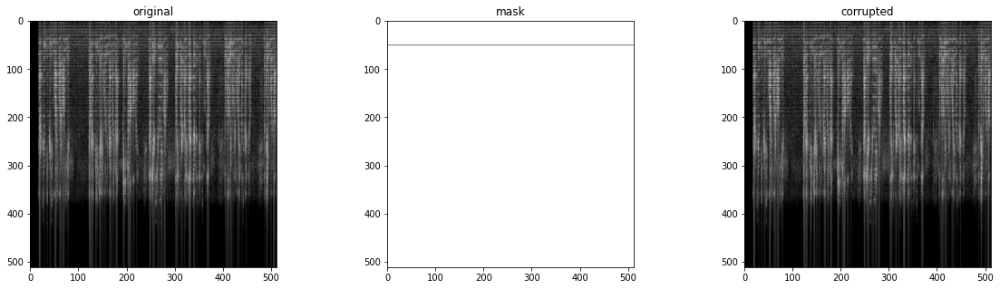

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 19 OUTPUT:



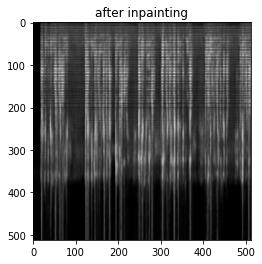


 ITERATION 1 - FILE 20...


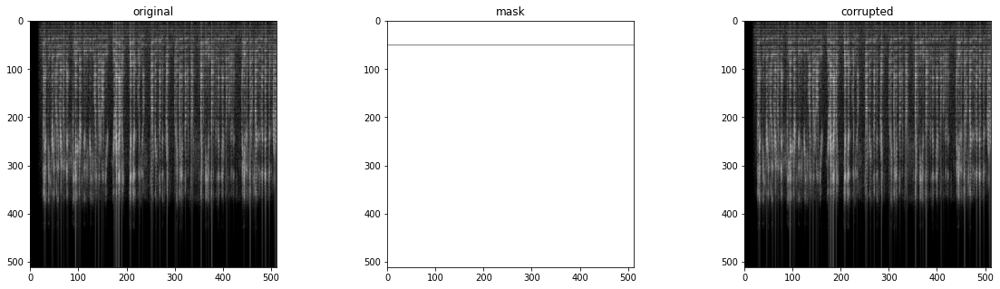

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 20 OUTPUT:



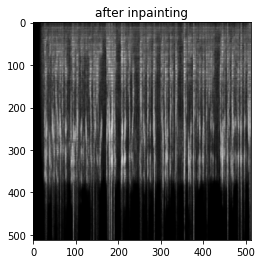


 ITERATION 1 - FILE 21...


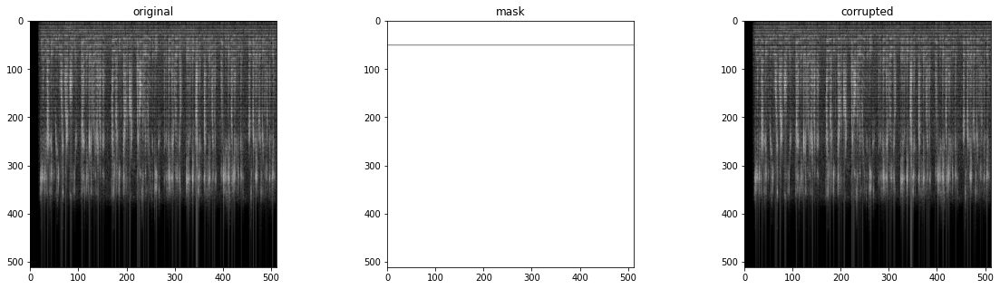

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 21 OUTPUT:



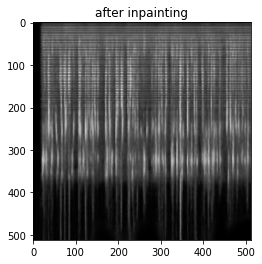


 ITERATION 1 - FILE 22...


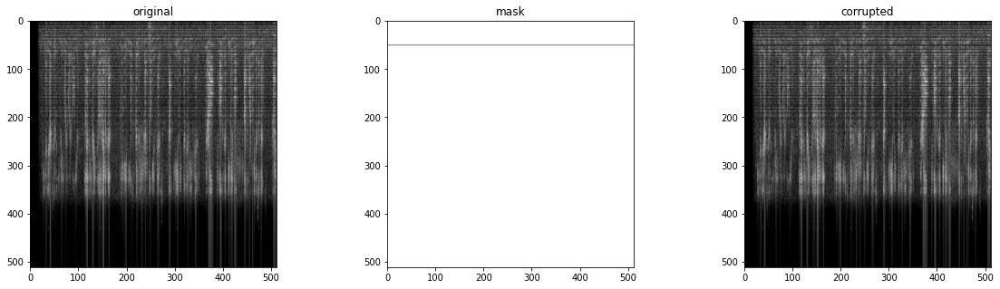

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 22 OUTPUT:



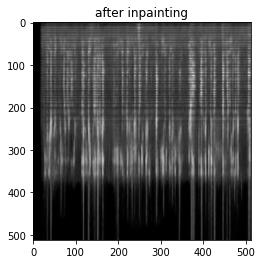


 ITERATION 1 - FILE 23...


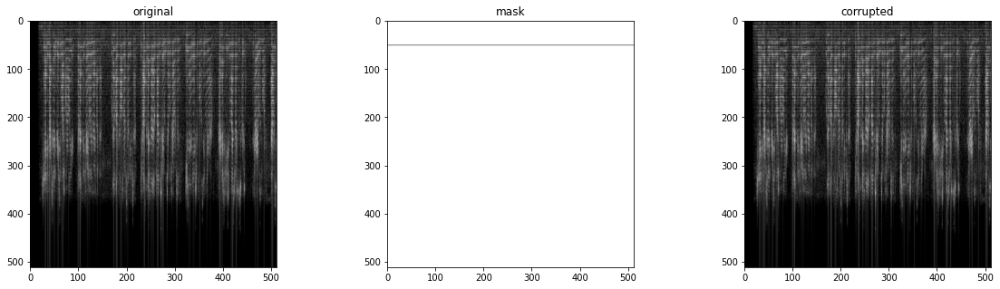

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 23 OUTPUT:



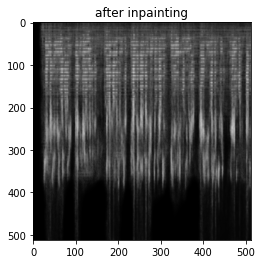


 ITERATION 1 - FILE 24...


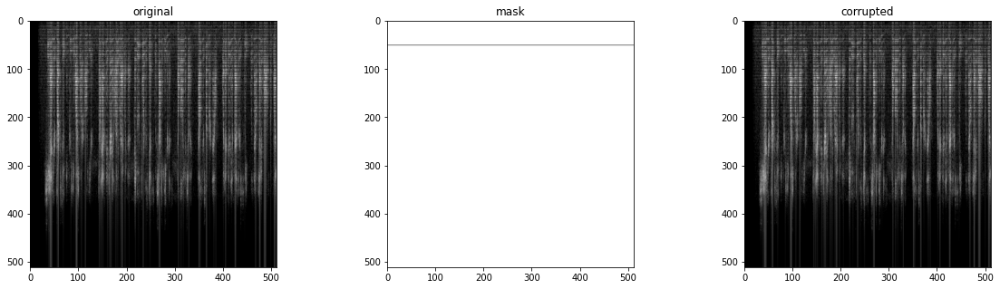

Number of params: 2962689
Starting optimization with ADAM

ITERATION 1 FILE 24 OUTPUT:



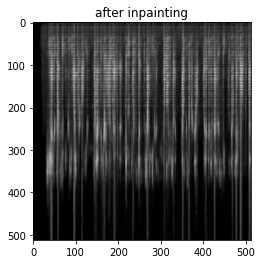


 ITERATION 2 - FILE 1...


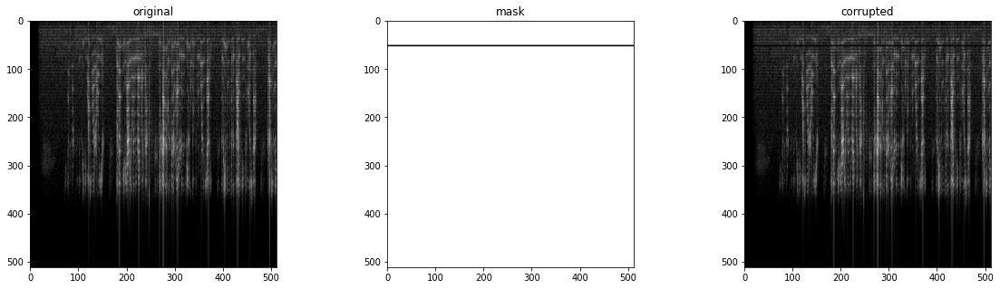

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 1 OUTPUT:



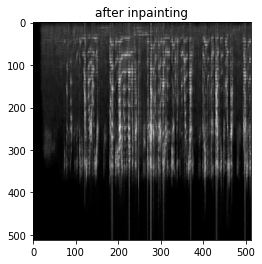


 ITERATION 2 - FILE 2...


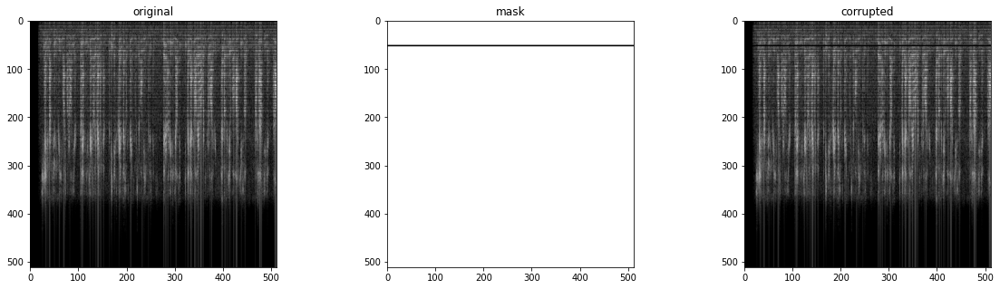

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 2 OUTPUT:



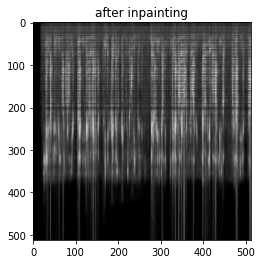


 ITERATION 2 - FILE 3...


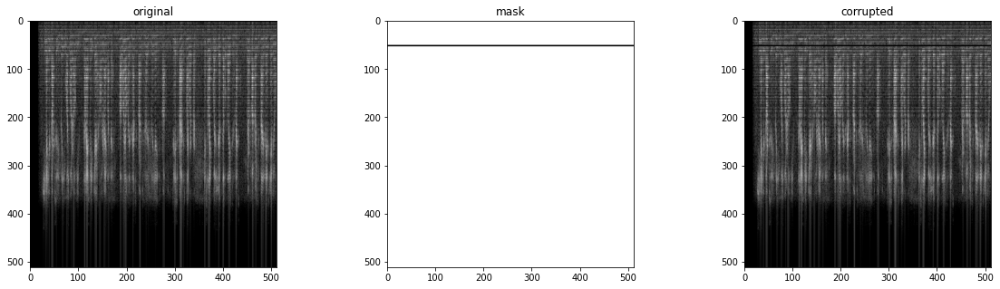

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 3 OUTPUT:



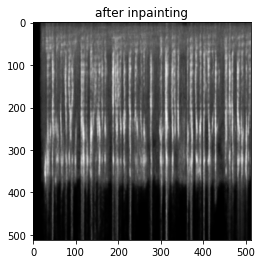


 ITERATION 2 - FILE 4...


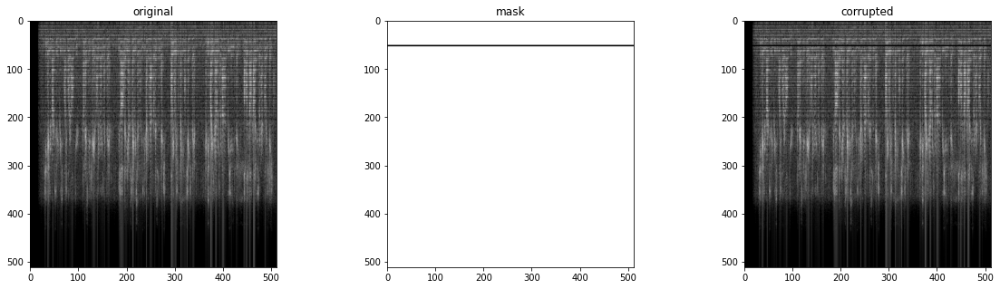

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 4 OUTPUT:



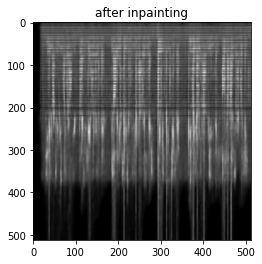


 ITERATION 2 - FILE 5...


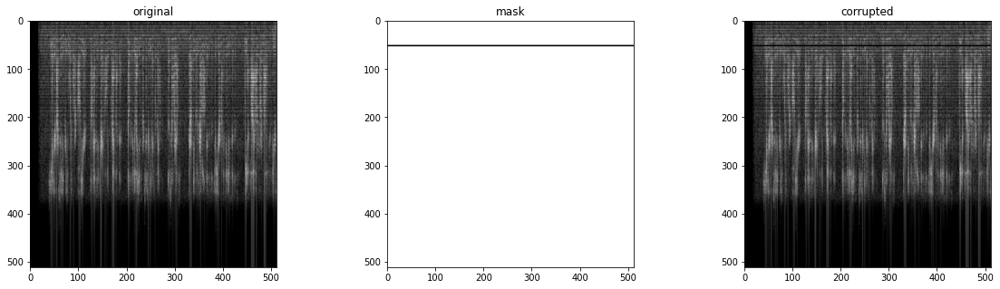

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 5 OUTPUT:



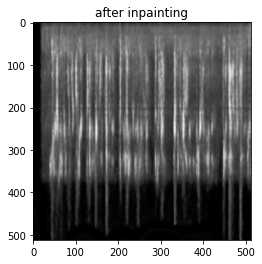


 ITERATION 2 - FILE 6...


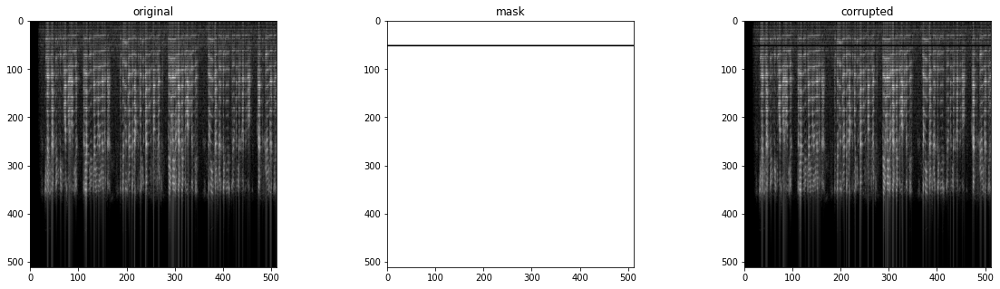

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 6 OUTPUT:



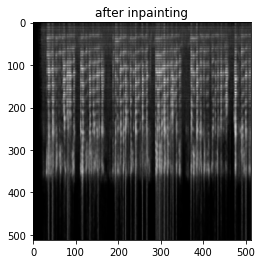


 ITERATION 2 - FILE 7...


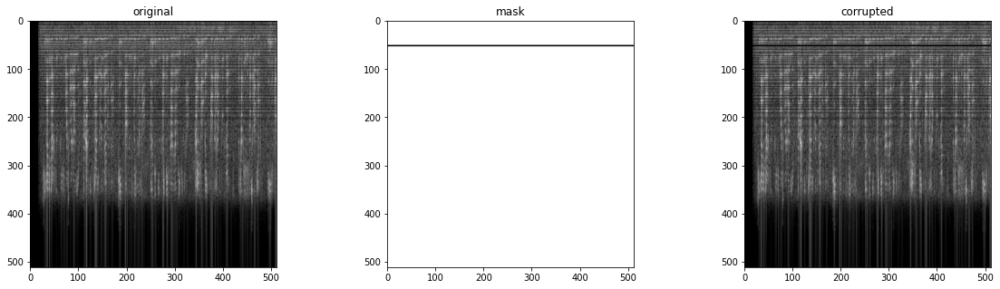

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 7 OUTPUT:



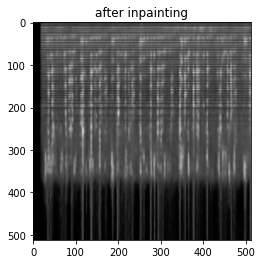


 ITERATION 2 - FILE 8...


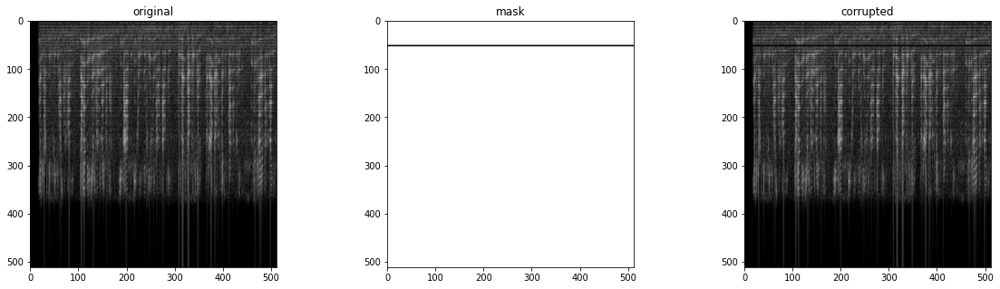

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 8 OUTPUT:



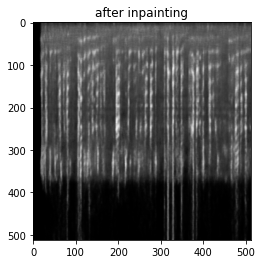


 ITERATION 2 - FILE 9...


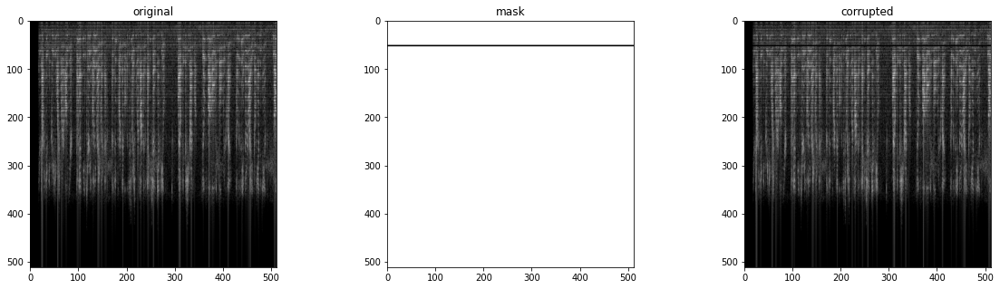

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 9 OUTPUT:



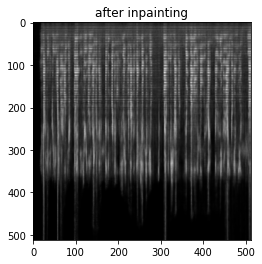


 ITERATION 2 - FILE 10...


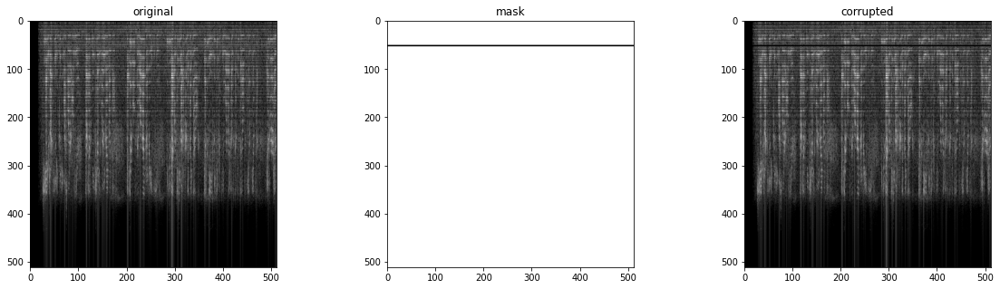

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 10 OUTPUT:



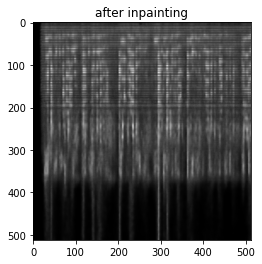


 ITERATION 2 - FILE 11...


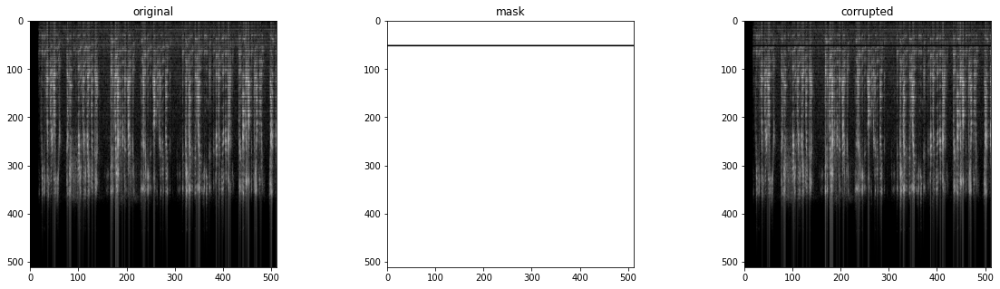

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 11 OUTPUT:



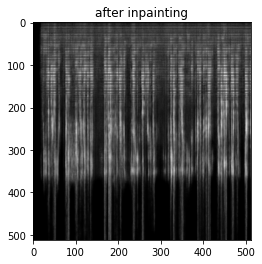


 ITERATION 2 - FILE 12...


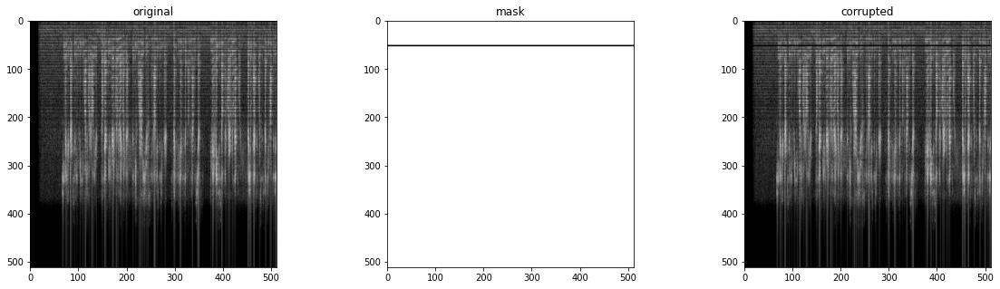

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 12 OUTPUT:



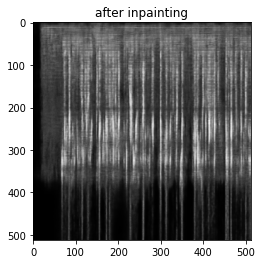


 ITERATION 2 - FILE 13...


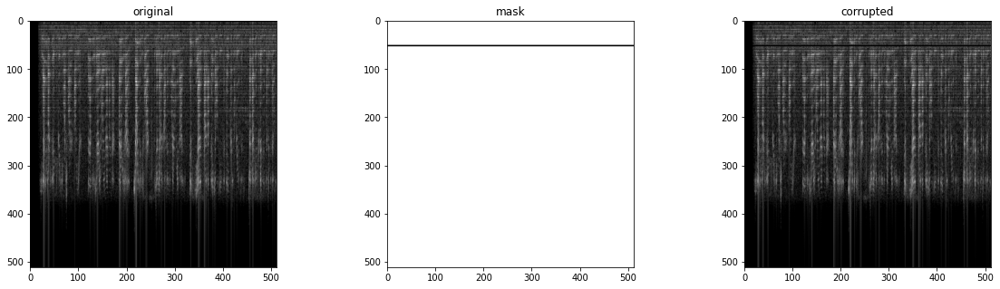

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 13 OUTPUT:



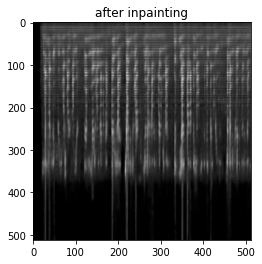


 ITERATION 2 - FILE 14...


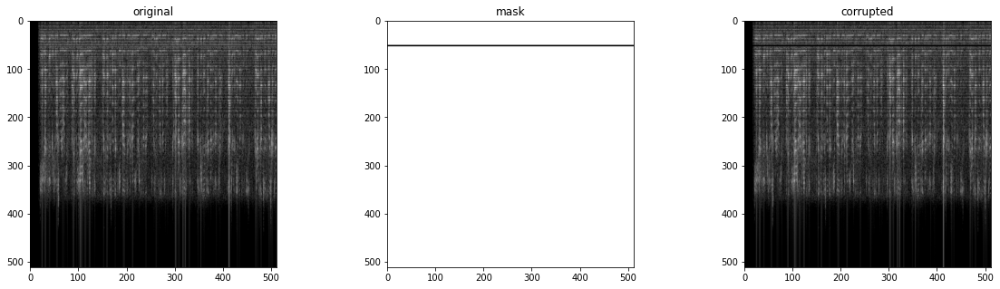

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 14 OUTPUT:



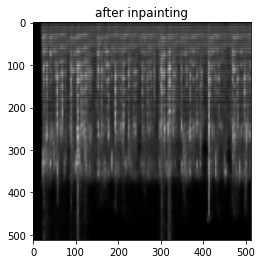


 ITERATION 2 - FILE 15...


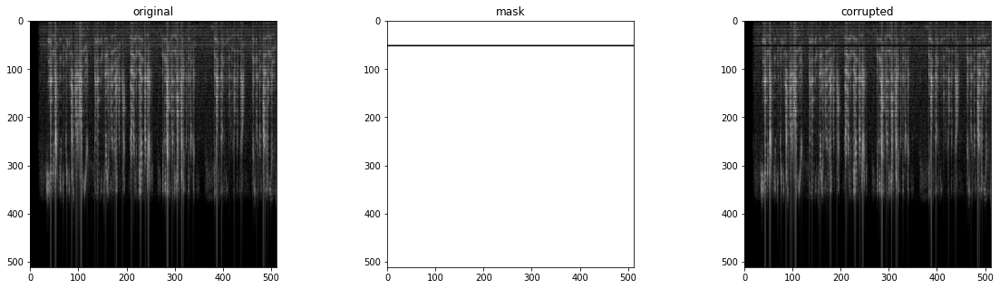

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 15 OUTPUT:



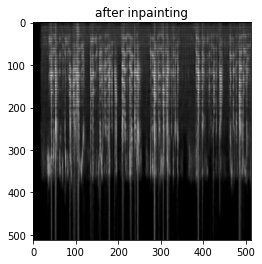


 ITERATION 2 - FILE 16...


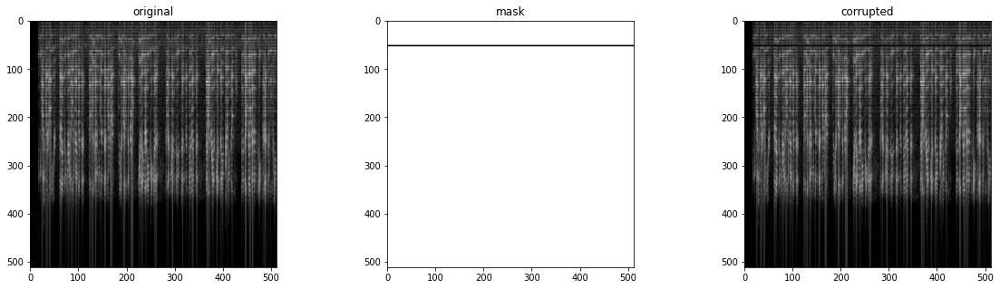

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 16 OUTPUT:



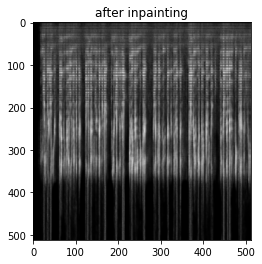


 ITERATION 2 - FILE 17...


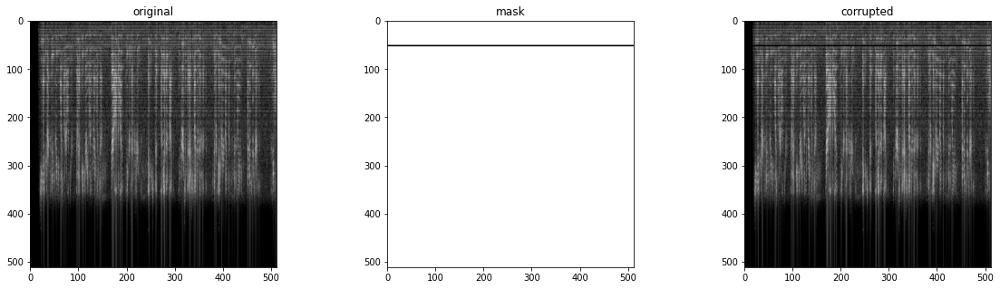

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 17 OUTPUT:



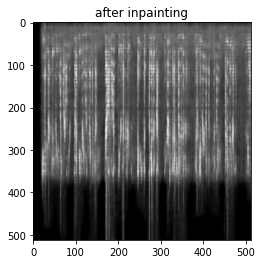


 ITERATION 2 - FILE 18...


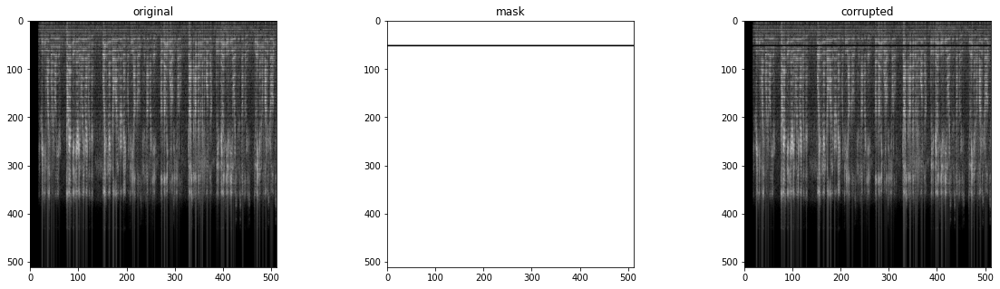

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 18 OUTPUT:



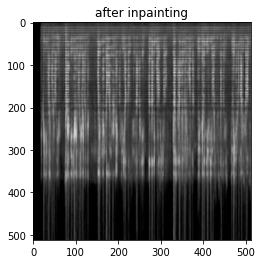


 ITERATION 2 - FILE 19...


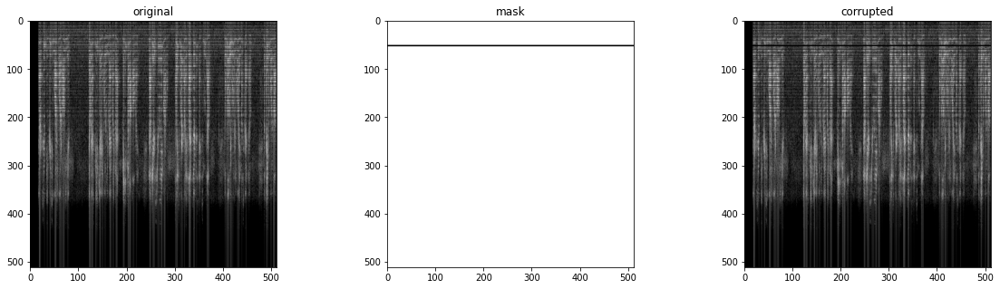

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 19 OUTPUT:



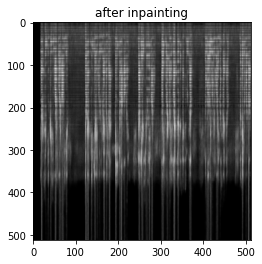


 ITERATION 2 - FILE 20...


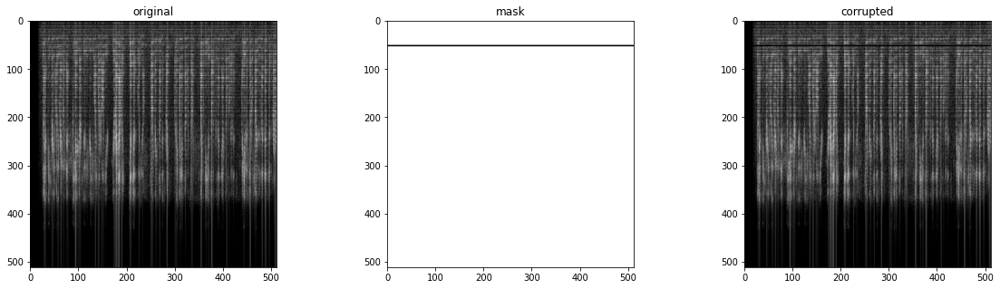

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 20 OUTPUT:



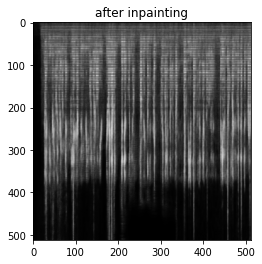


 ITERATION 2 - FILE 21...


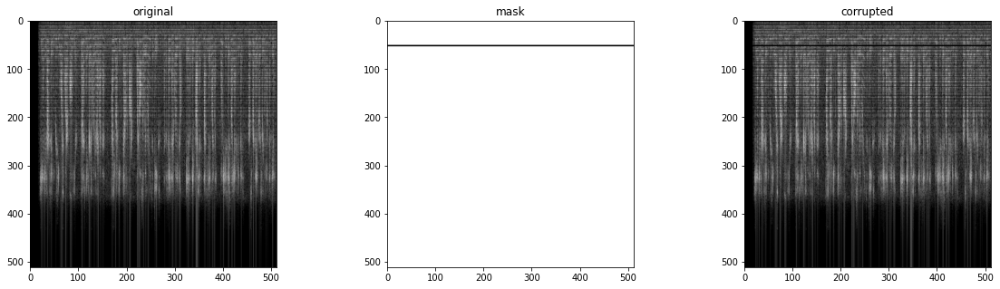

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 21 OUTPUT:



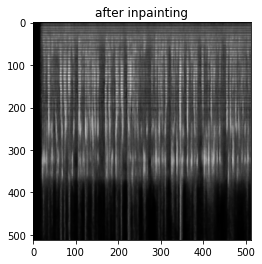


 ITERATION 2 - FILE 22...


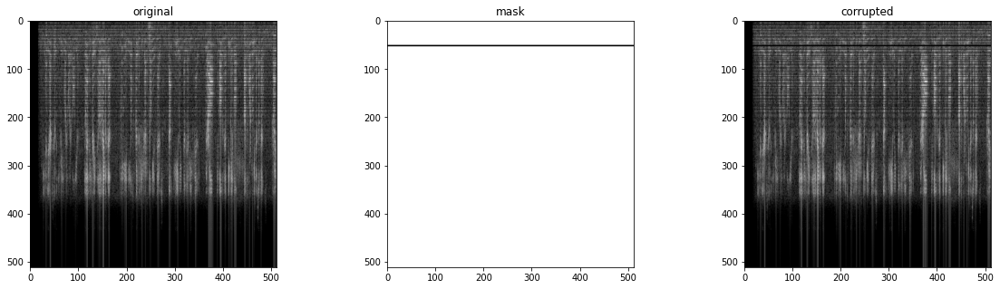

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 22 OUTPUT:



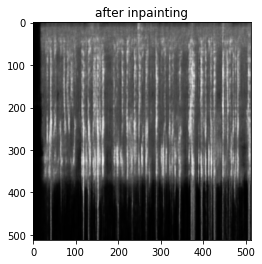


 ITERATION 2 - FILE 23...


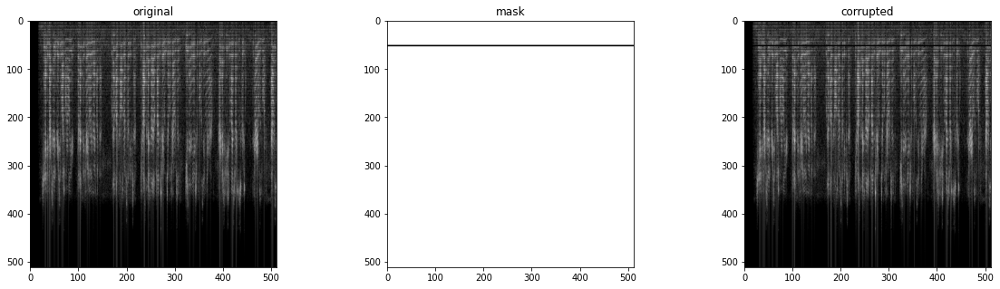

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 23 OUTPUT:



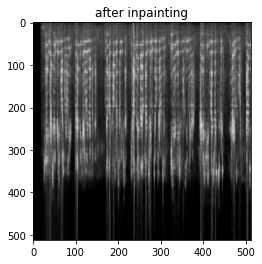


 ITERATION 2 - FILE 24...


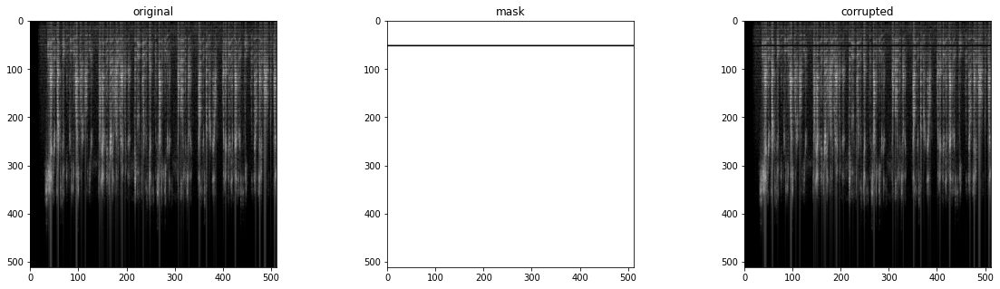

Number of params: 2962689
Starting optimization with ADAM

ITERATION 2 FILE 24 OUTPUT:



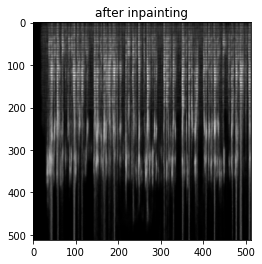


 ITERATION 3 - FILE 1...


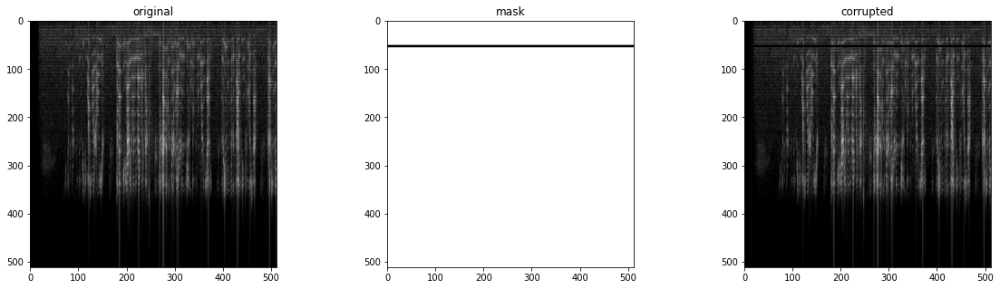

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 1 OUTPUT:



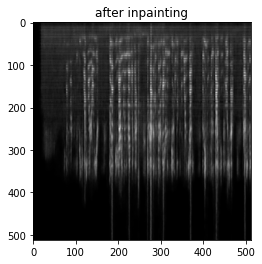


 ITERATION 3 - FILE 2...


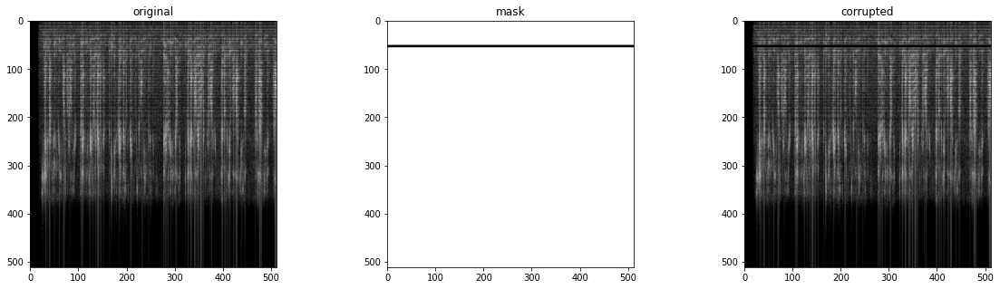

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 2 OUTPUT:



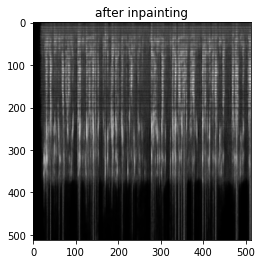


 ITERATION 3 - FILE 3...


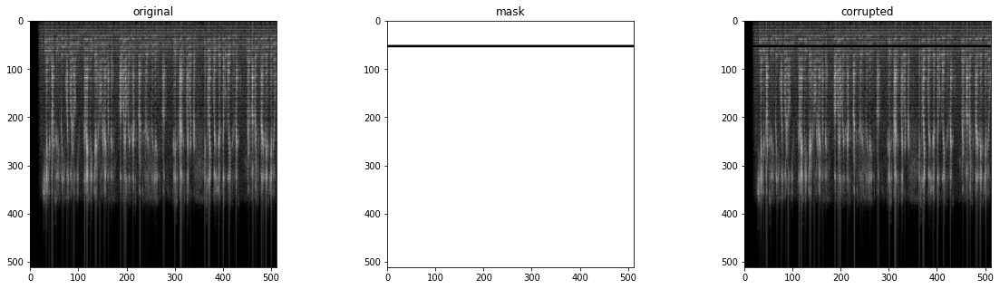

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 3 OUTPUT:



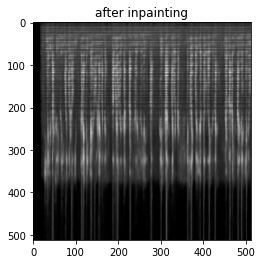


 ITERATION 3 - FILE 4...


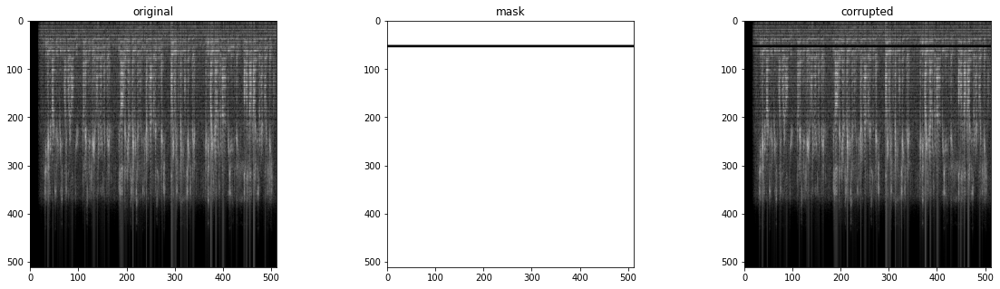

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 4 OUTPUT:



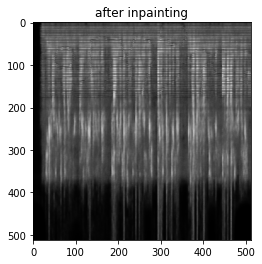


 ITERATION 3 - FILE 5...


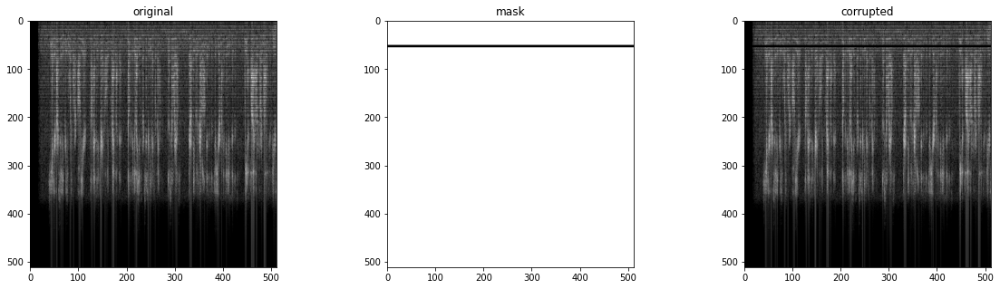

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 5 OUTPUT:



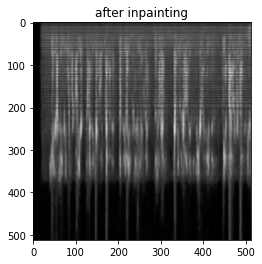


 ITERATION 3 - FILE 6...


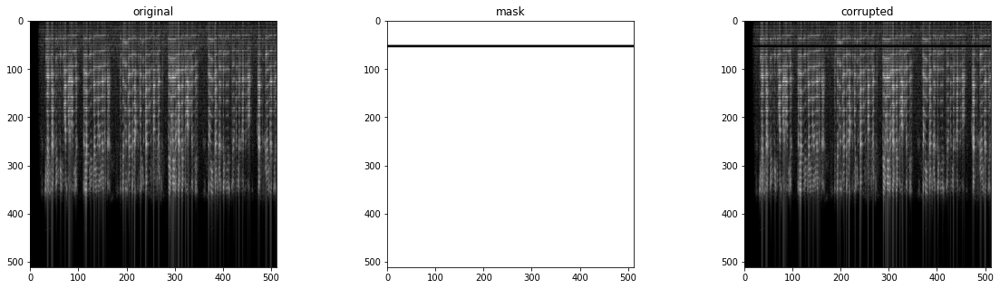

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 6 OUTPUT:



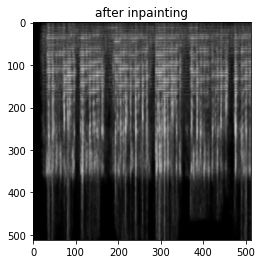


 ITERATION 3 - FILE 7...


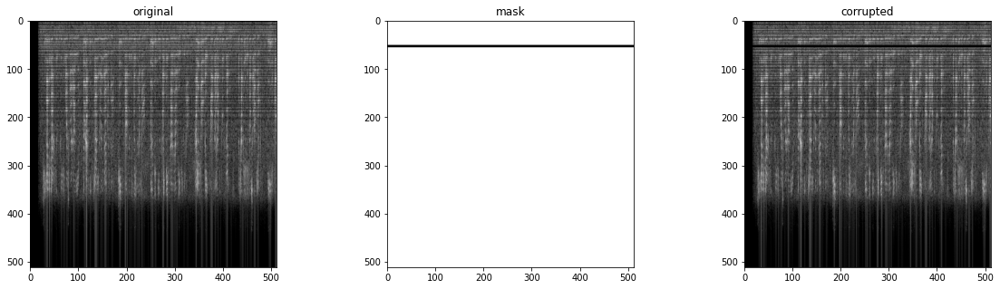

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 7 OUTPUT:



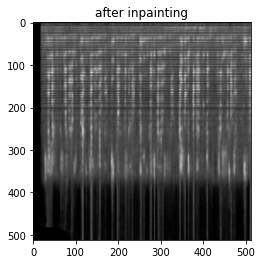


 ITERATION 3 - FILE 8...


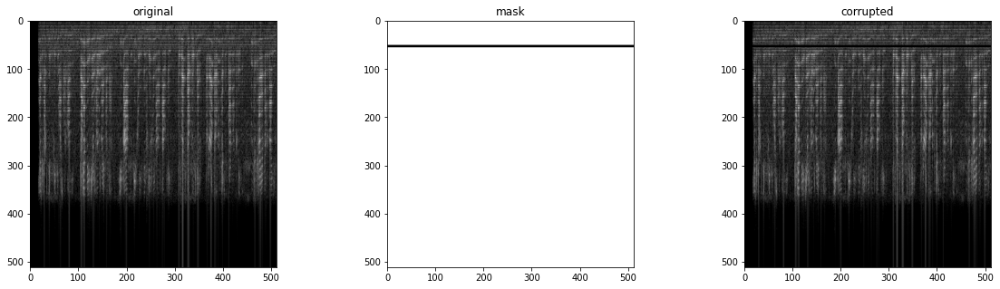

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 8 OUTPUT:



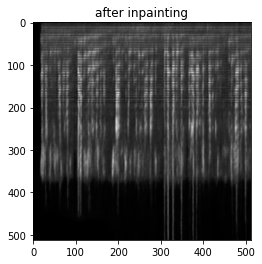


 ITERATION 3 - FILE 9...


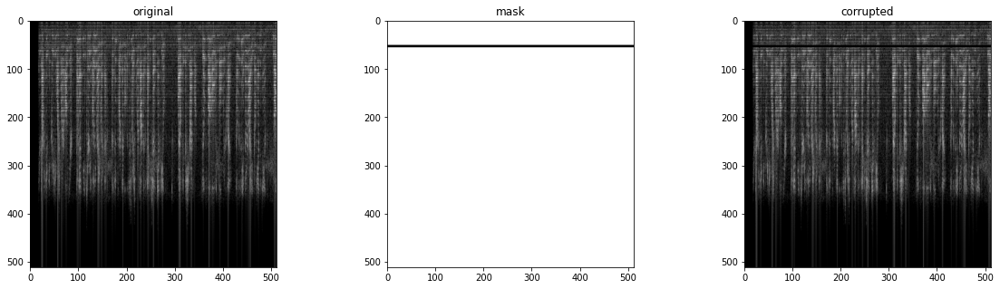

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 9 OUTPUT:



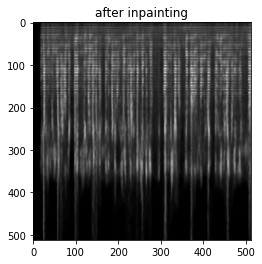


 ITERATION 3 - FILE 10...


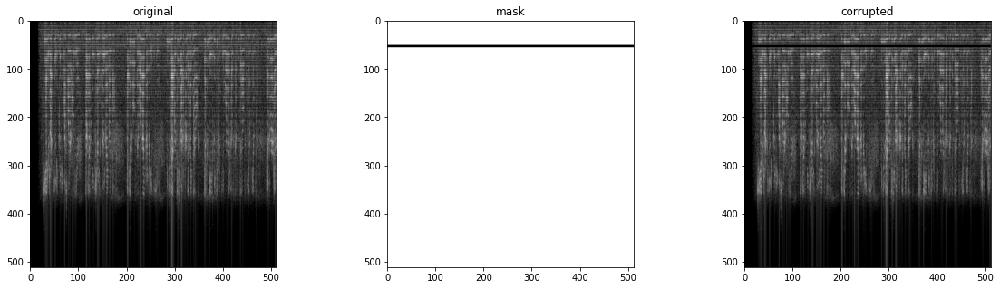

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 10 OUTPUT:



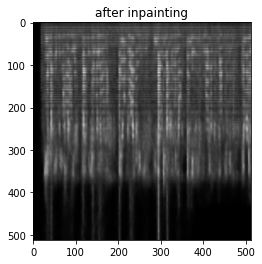


 ITERATION 3 - FILE 11...


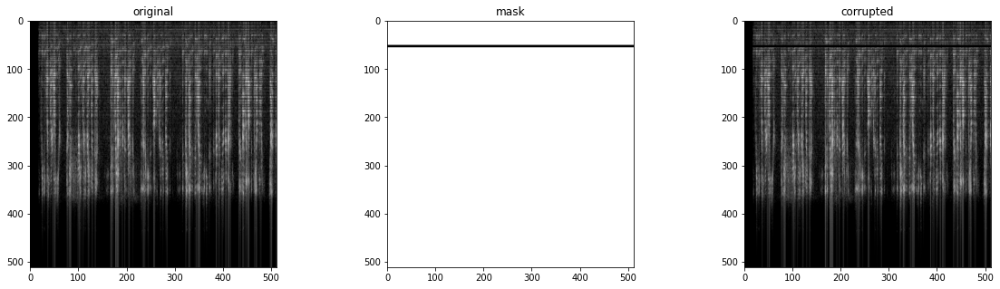

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 11 OUTPUT:



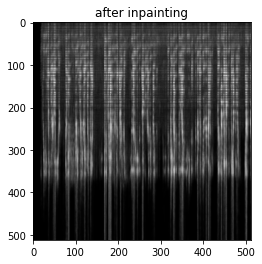


 ITERATION 3 - FILE 12...


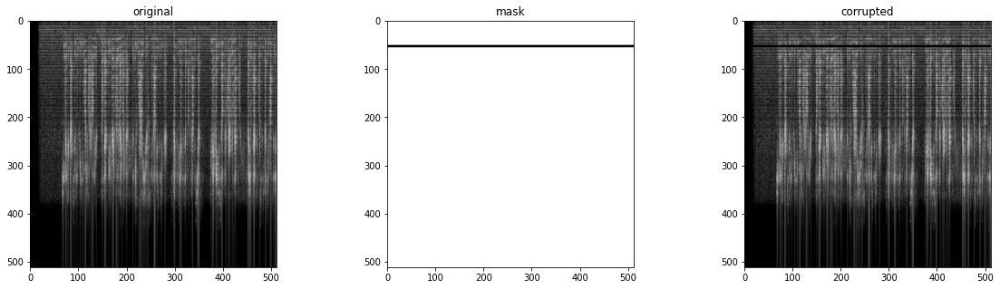

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 12 OUTPUT:



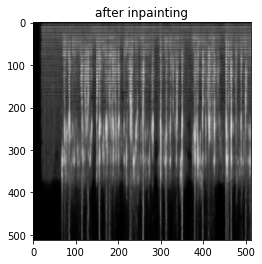


 ITERATION 3 - FILE 13...


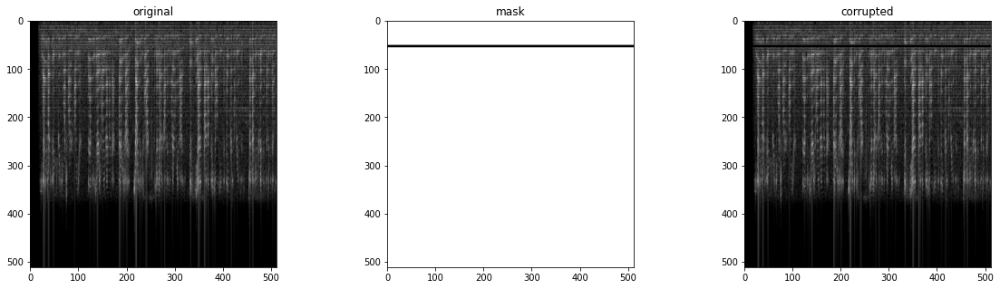

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 13 OUTPUT:



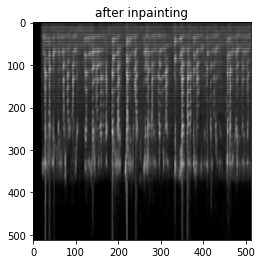


 ITERATION 3 - FILE 14...


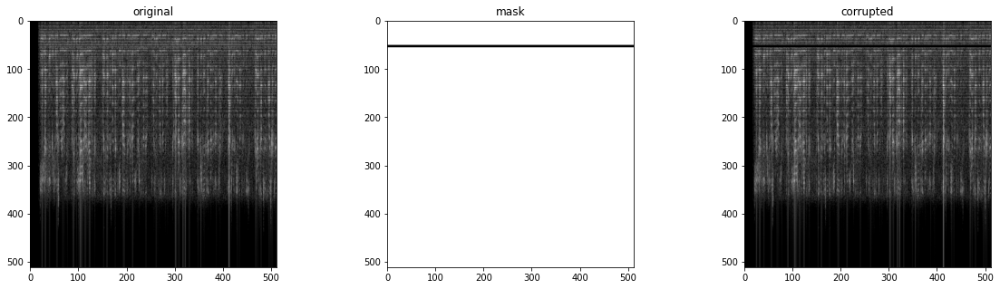

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 14 OUTPUT:



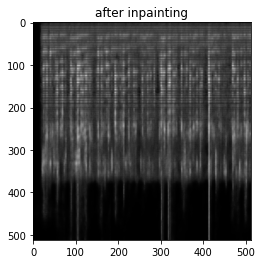


 ITERATION 3 - FILE 15...


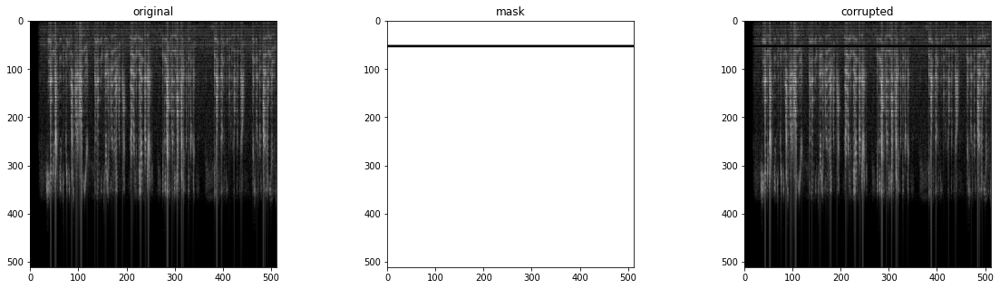

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 15 OUTPUT:



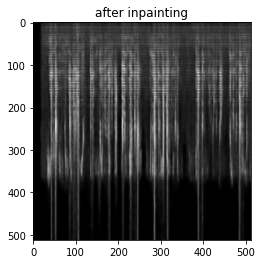


 ITERATION 3 - FILE 16...


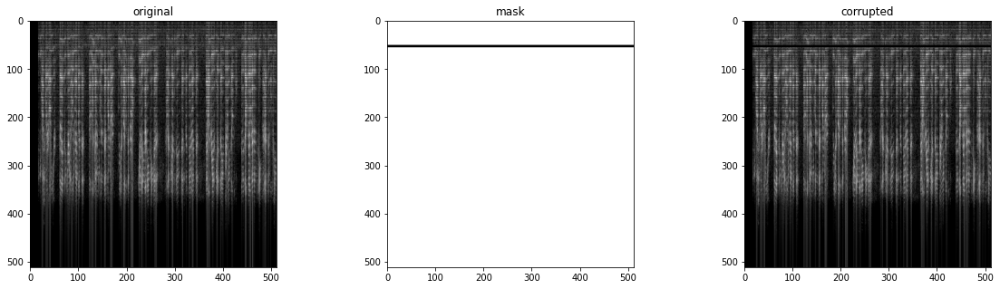

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 16 OUTPUT:



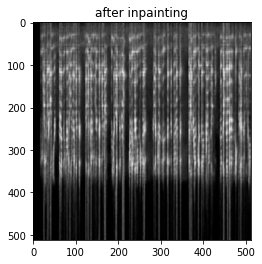


 ITERATION 3 - FILE 17...


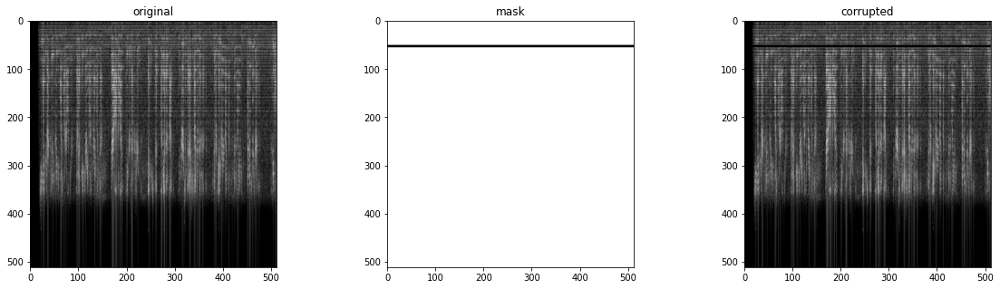

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 17 OUTPUT:



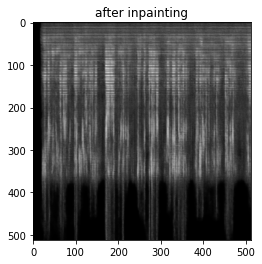


 ITERATION 3 - FILE 18...


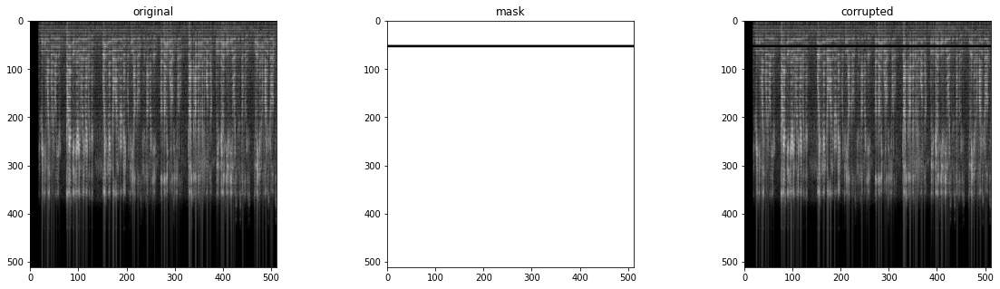

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 18 OUTPUT:



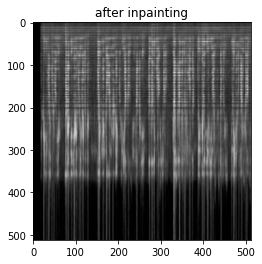


 ITERATION 3 - FILE 19...


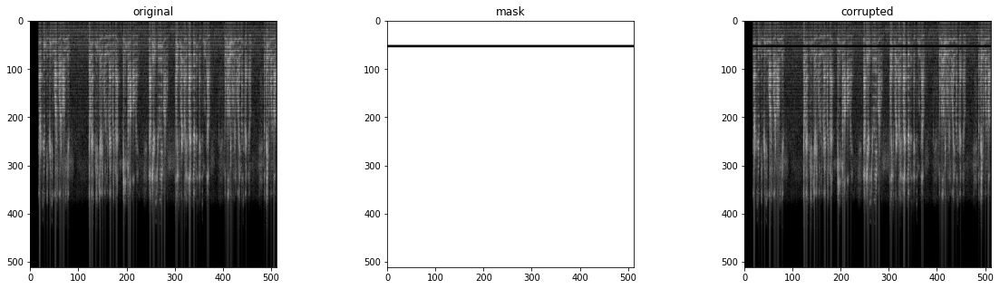

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 19 OUTPUT:



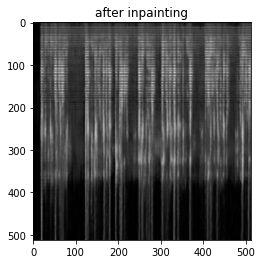


 ITERATION 3 - FILE 20...


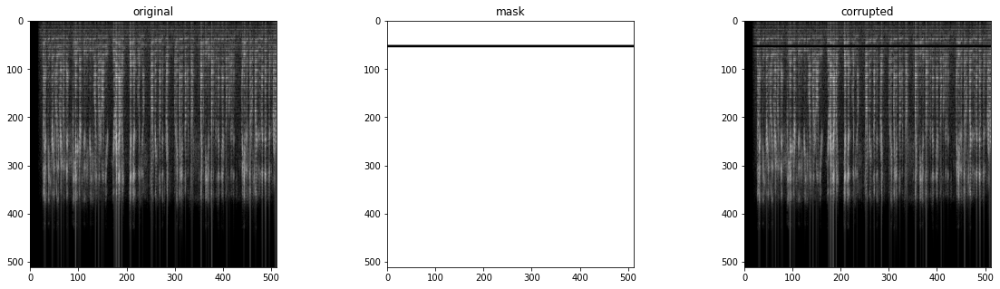

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 20 OUTPUT:



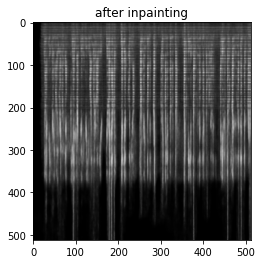


 ITERATION 3 - FILE 21...


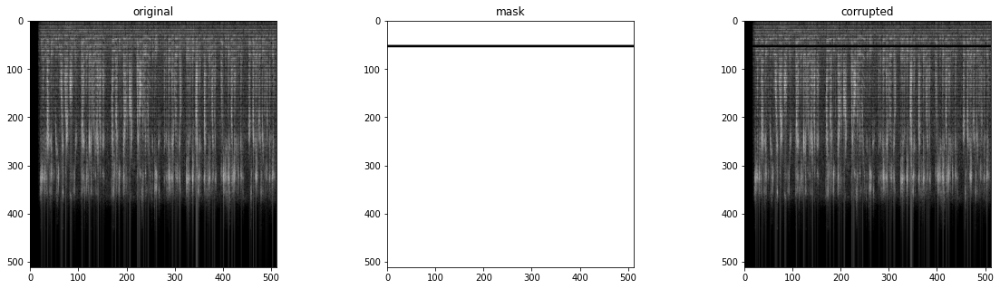

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 21 OUTPUT:



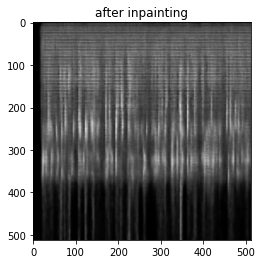


 ITERATION 3 - FILE 22...


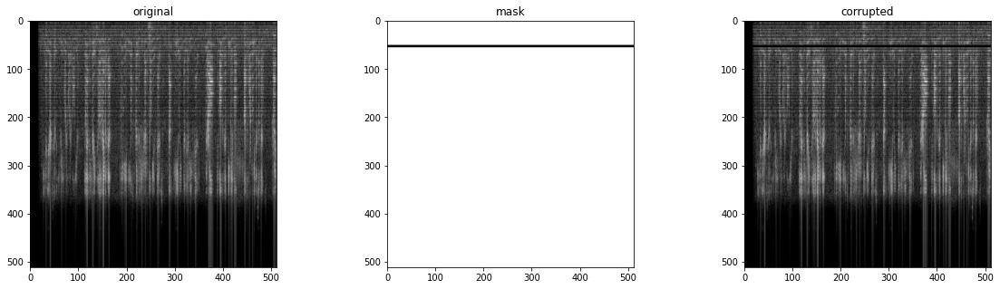

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 22 OUTPUT:



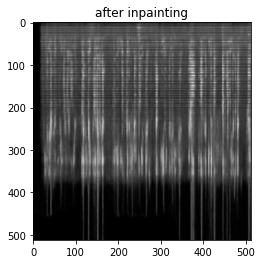


 ITERATION 3 - FILE 23...


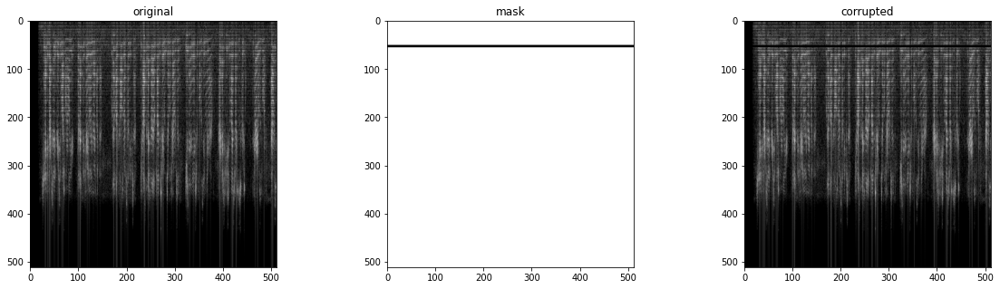

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 23 OUTPUT:



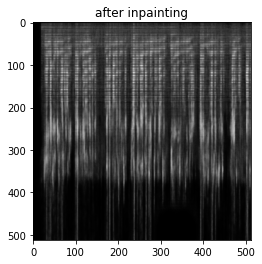


 ITERATION 3 - FILE 24...


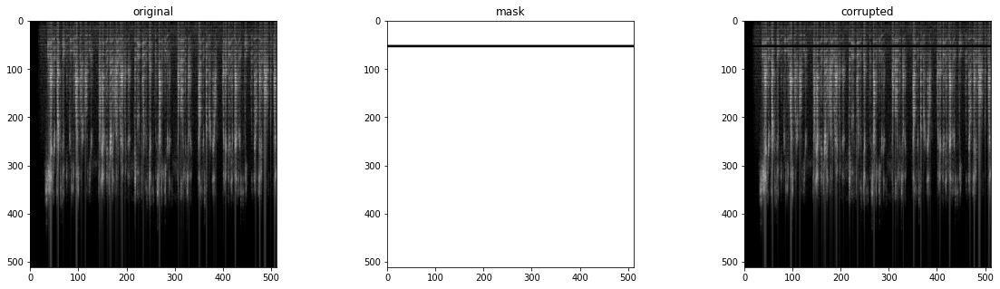

Number of params: 2962689
Starting optimization with ADAM

ITERATION 3 FILE 24 OUTPUT:



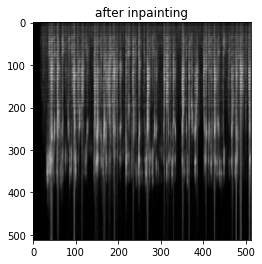


 ITERATION 4 - FILE 1...


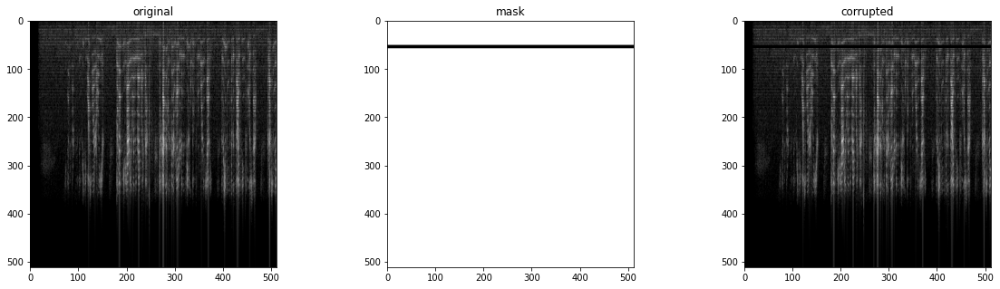

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 1 OUTPUT:



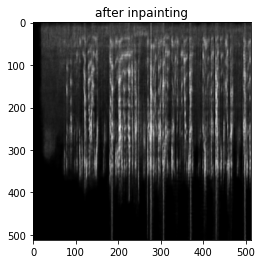


 ITERATION 4 - FILE 2...


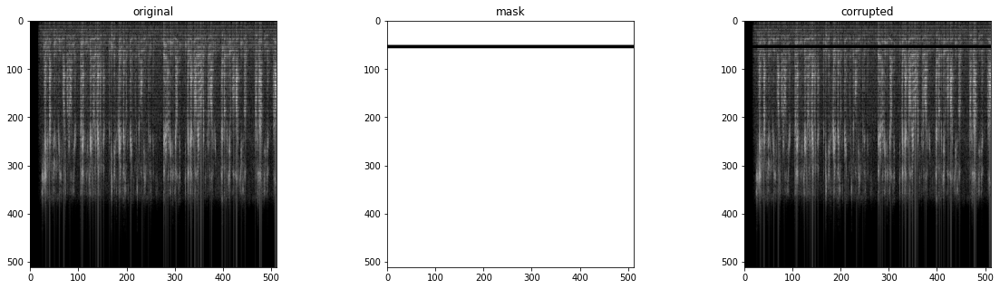

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 2 OUTPUT:



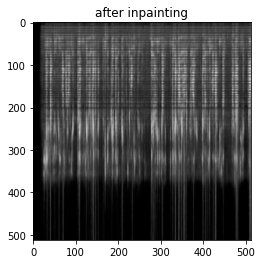


 ITERATION 4 - FILE 3...


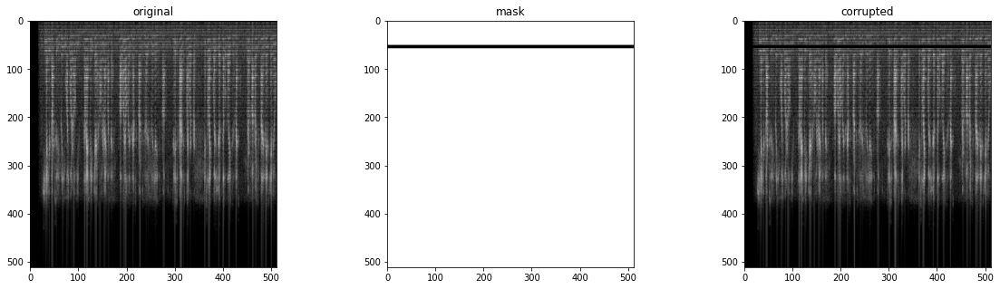

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 3 OUTPUT:



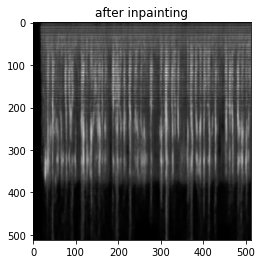


 ITERATION 4 - FILE 4...


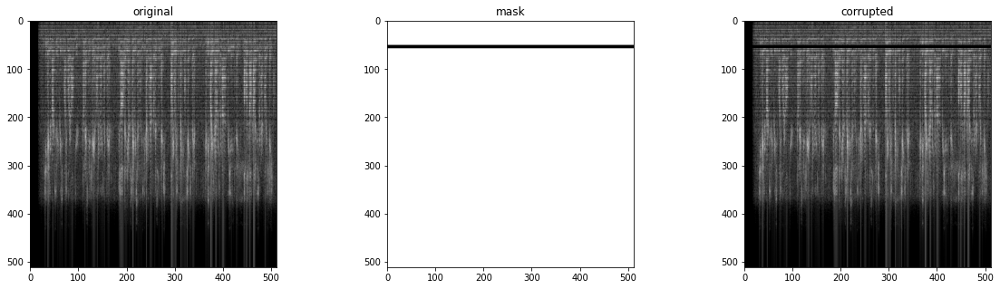

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 4 OUTPUT:



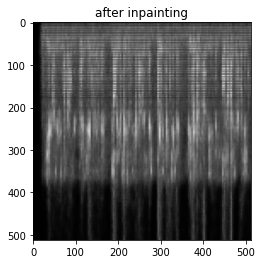


 ITERATION 4 - FILE 5...


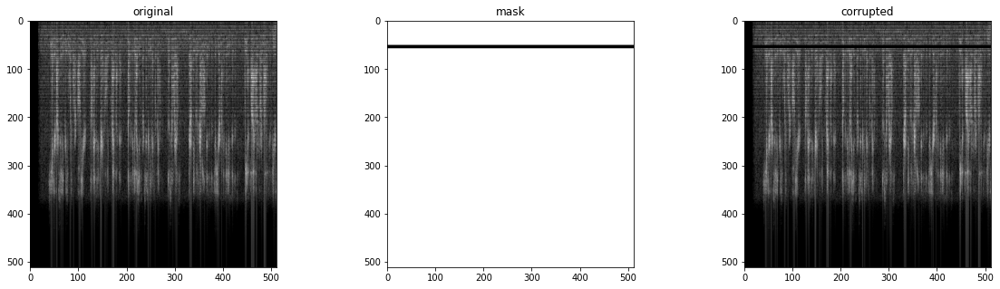

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 5 OUTPUT:



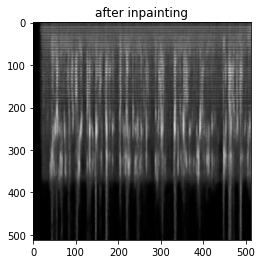


 ITERATION 4 - FILE 6...


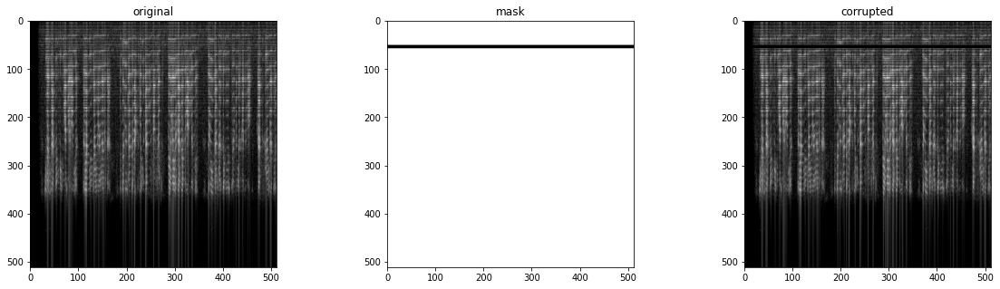

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 6 OUTPUT:



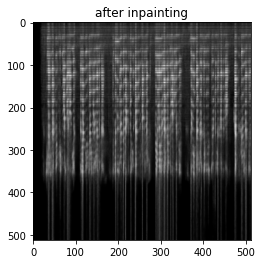


 ITERATION 4 - FILE 7...


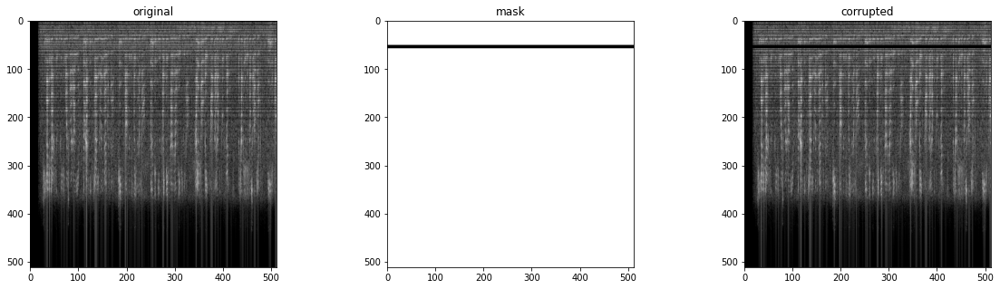

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 7 OUTPUT:



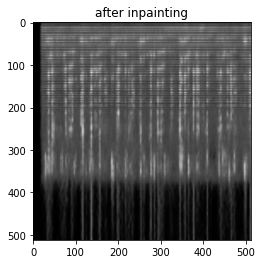


 ITERATION 4 - FILE 8...


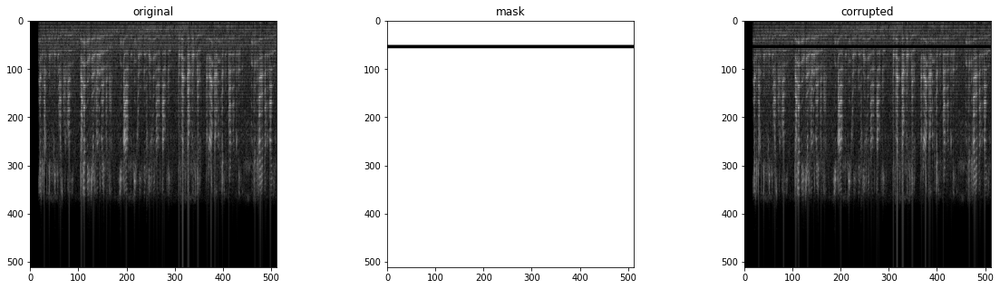

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 8 OUTPUT:



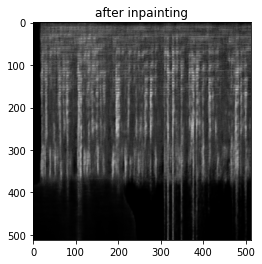


 ITERATION 4 - FILE 9...


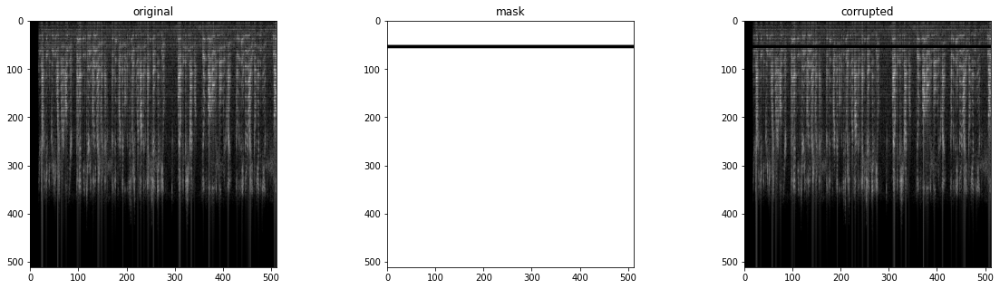

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 9 OUTPUT:



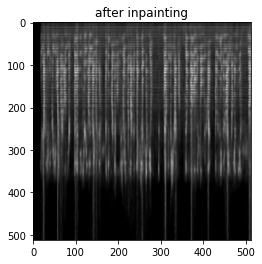


 ITERATION 4 - FILE 10...


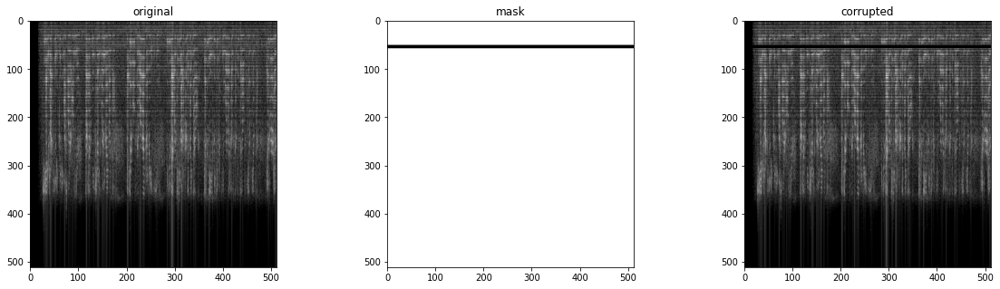

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 10 OUTPUT:



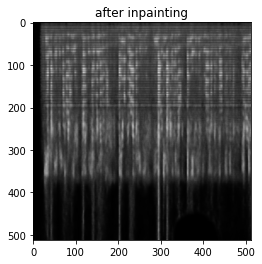


 ITERATION 4 - FILE 11...


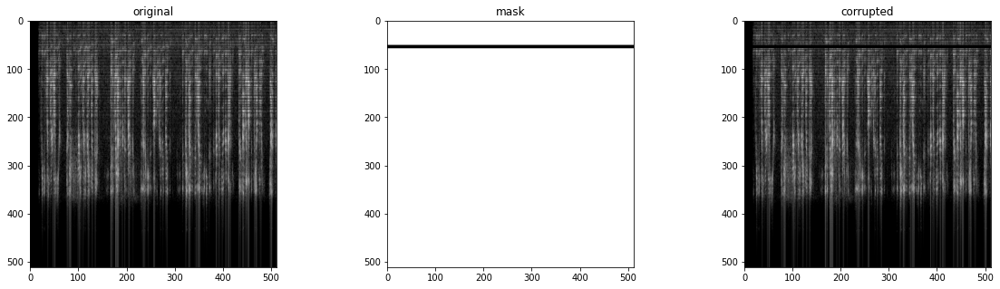

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 11 OUTPUT:



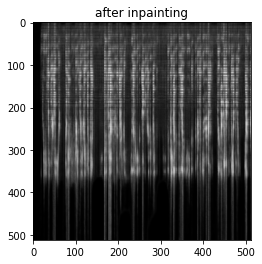


 ITERATION 4 - FILE 12...


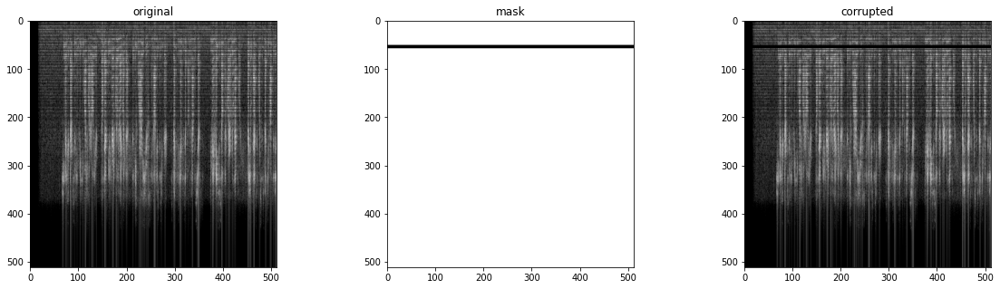

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 12 OUTPUT:



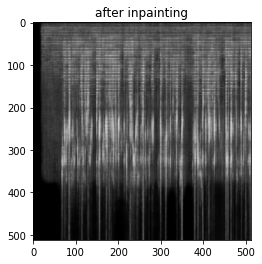


 ITERATION 4 - FILE 13...


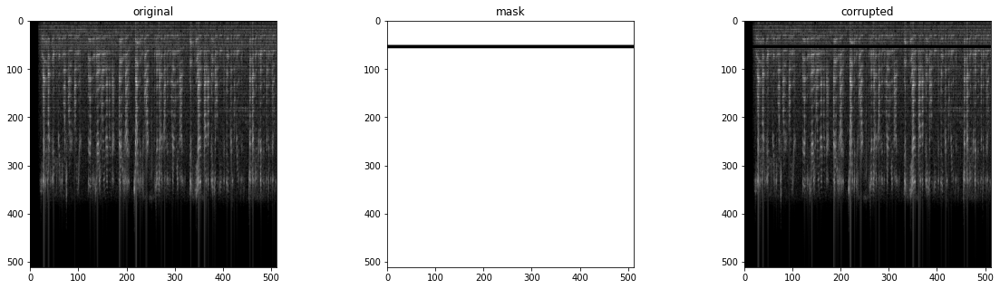

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 13 OUTPUT:



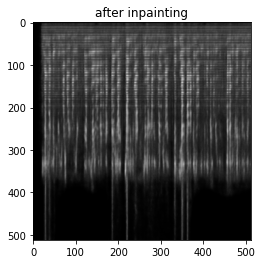


 ITERATION 4 - FILE 14...


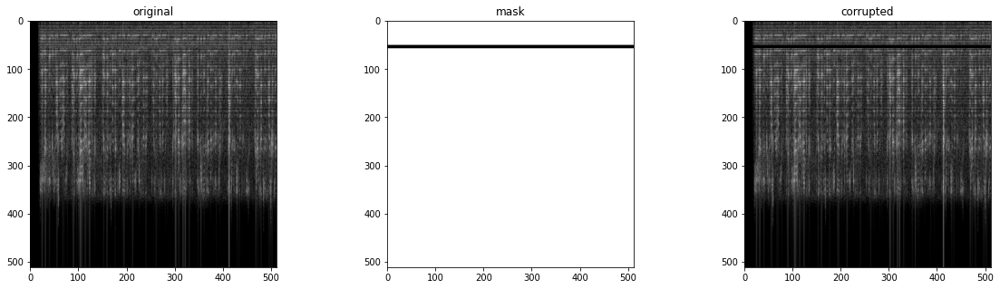

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 14 OUTPUT:



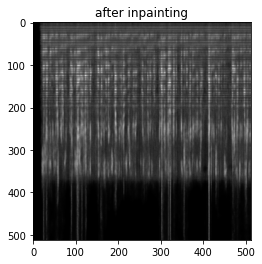


 ITERATION 4 - FILE 15...


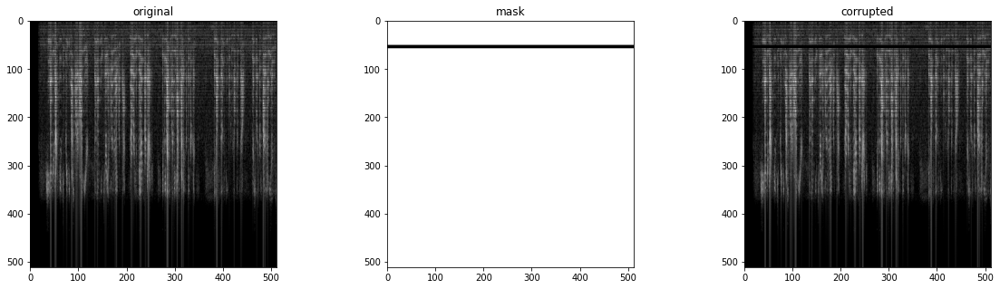

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 15 OUTPUT:



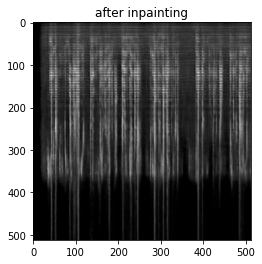


 ITERATION 4 - FILE 16...


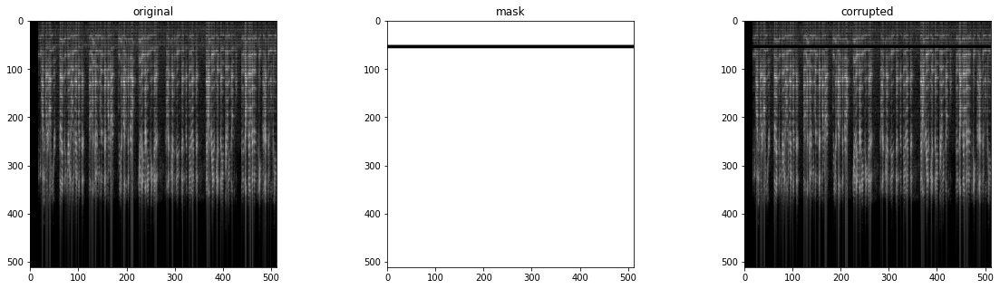

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 16 OUTPUT:



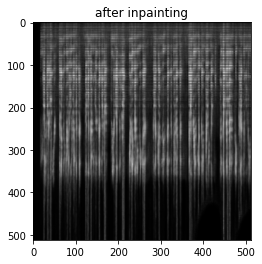


 ITERATION 4 - FILE 17...


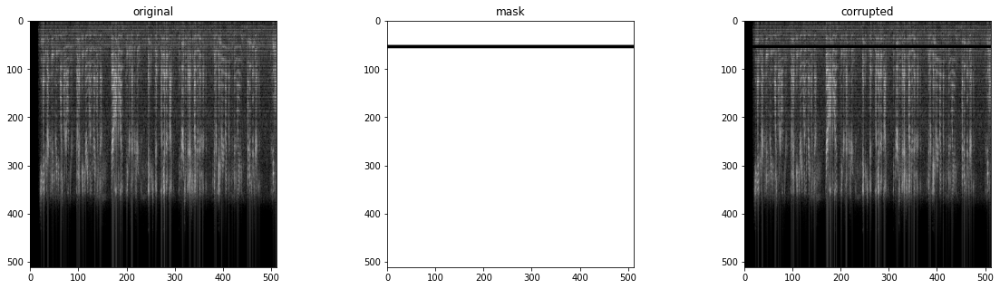

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 17 OUTPUT:



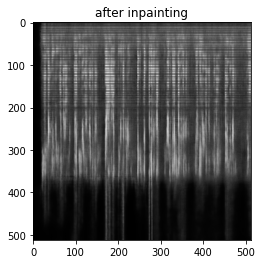


 ITERATION 4 - FILE 18...


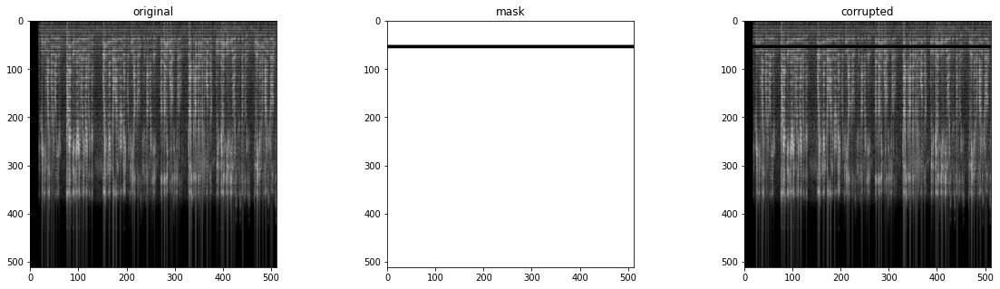

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 18 OUTPUT:



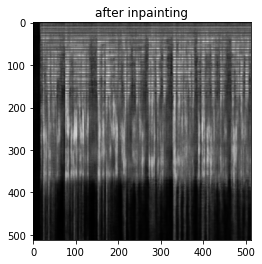


 ITERATION 4 - FILE 19...


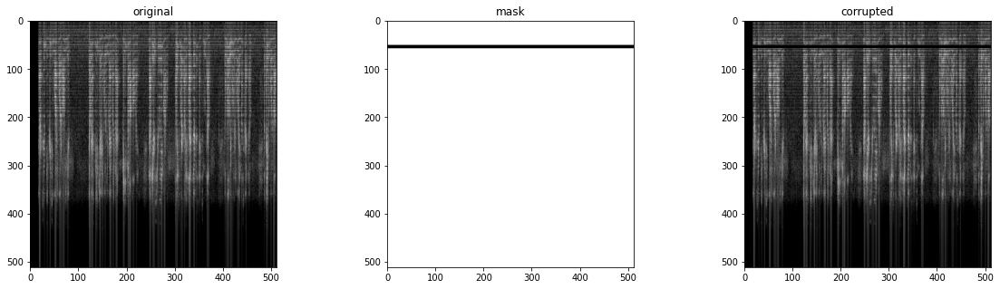

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 19 OUTPUT:



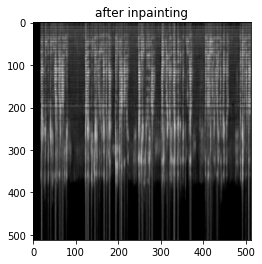


 ITERATION 4 - FILE 20...


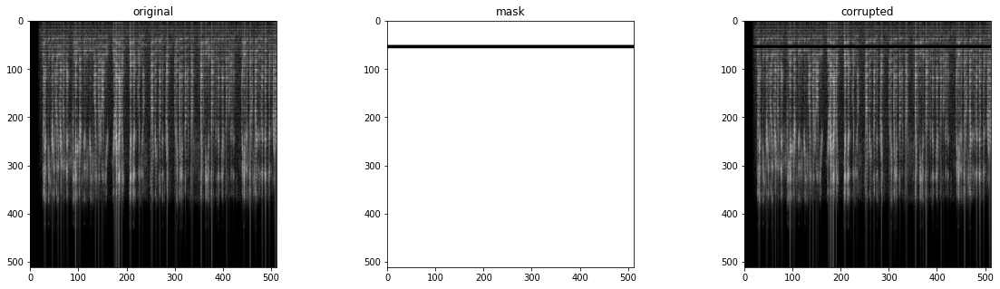

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 20 OUTPUT:



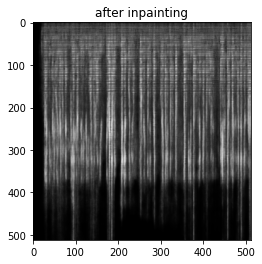


 ITERATION 4 - FILE 21...


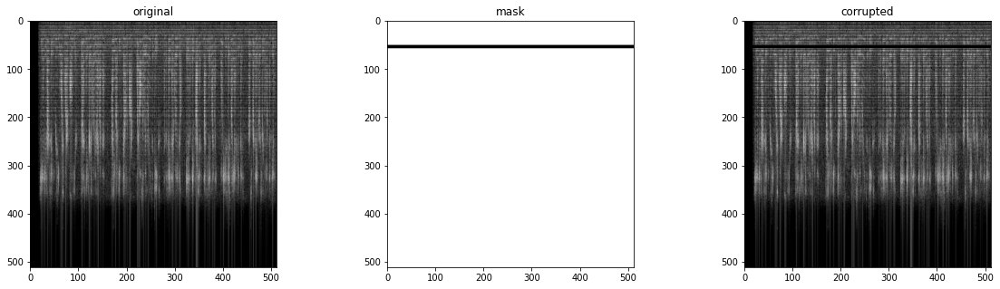

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 21 OUTPUT:



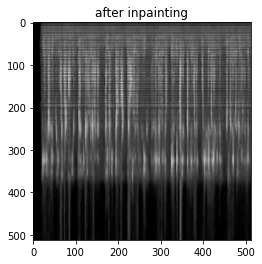


 ITERATION 4 - FILE 22...


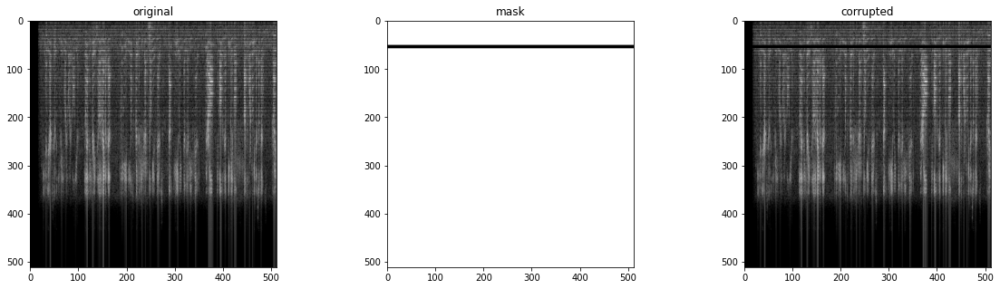

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 22 OUTPUT:



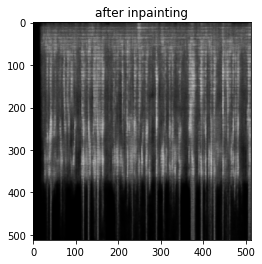


 ITERATION 4 - FILE 23...


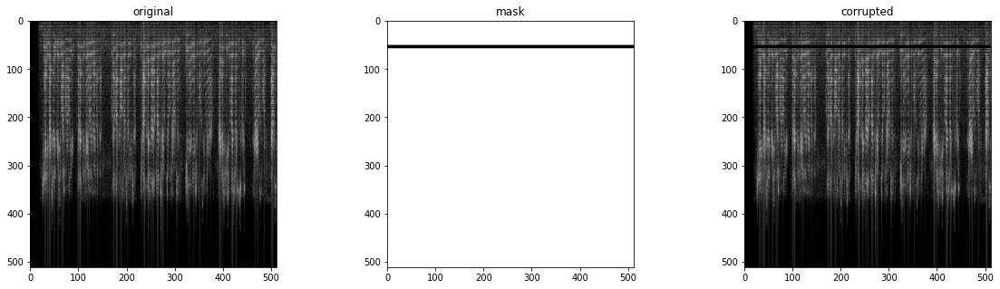

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 23 OUTPUT:



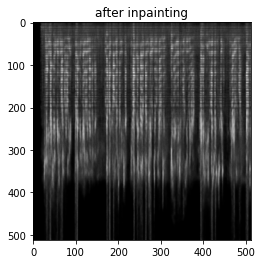


 ITERATION 4 - FILE 24...


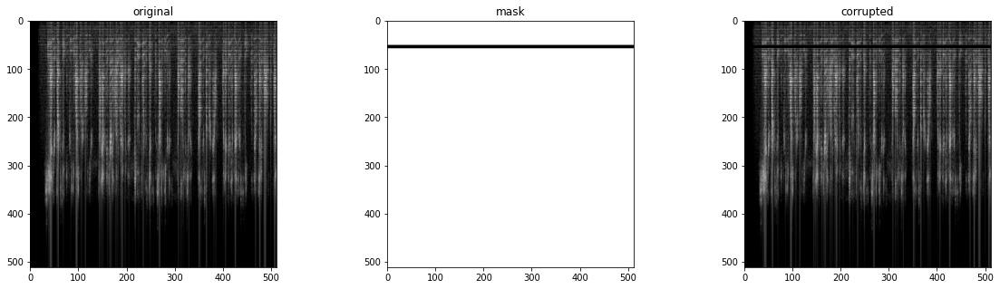

Number of params: 2962689
Starting optimization with ADAM

ITERATION 4 FILE 24 OUTPUT:



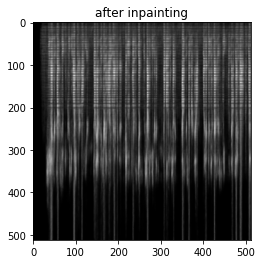


 ITERATION 5 - FILE 1...


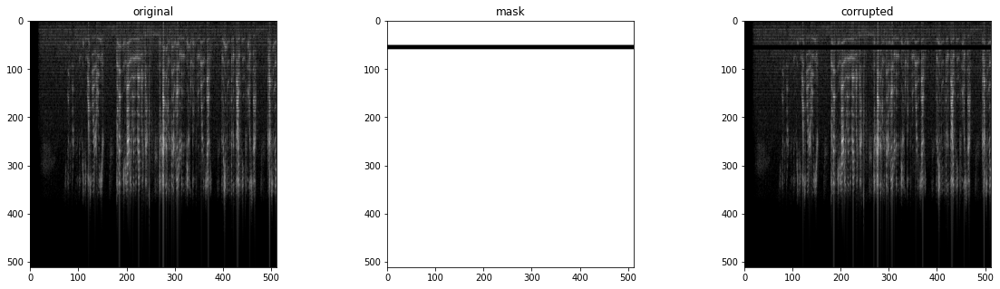

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 1 OUTPUT:



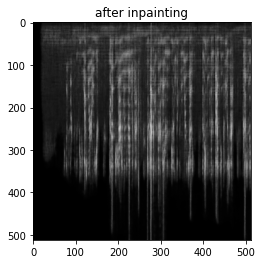


 ITERATION 5 - FILE 2...


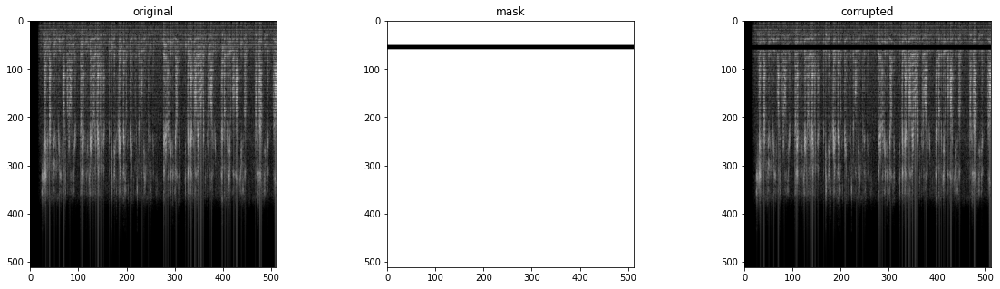

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 2 OUTPUT:



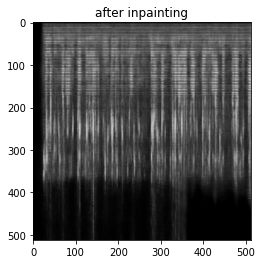


 ITERATION 5 - FILE 3...


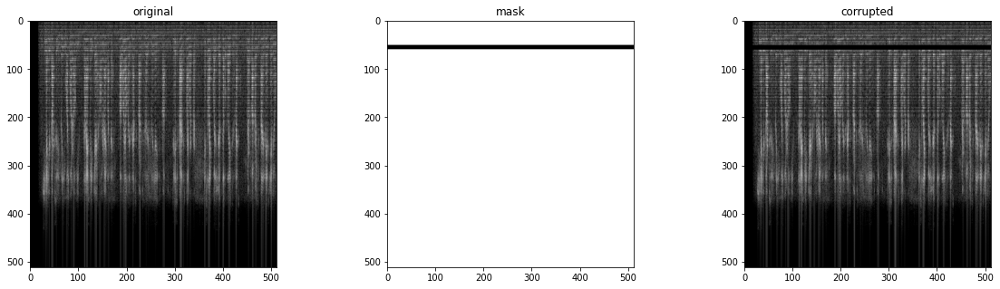

Number of params: 2962689
Starting optimization with ADAM
Iteration 184058    Loss 0.015511 
ITERATION 5 FILE 3 OUTPUT:



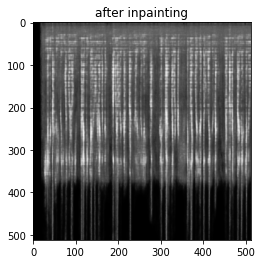


 ITERATION 5 - FILE 4...


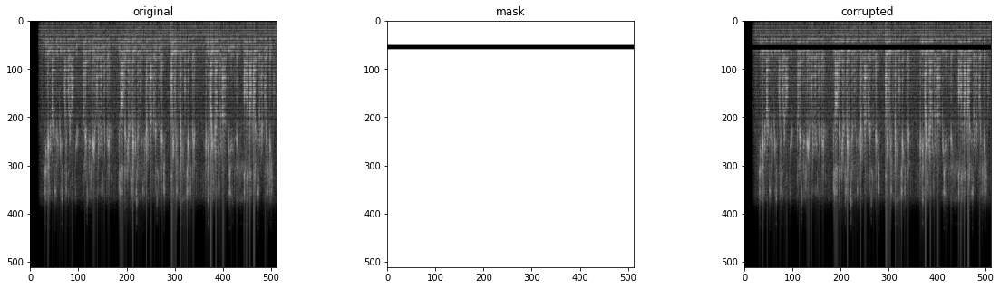

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 4 OUTPUT:



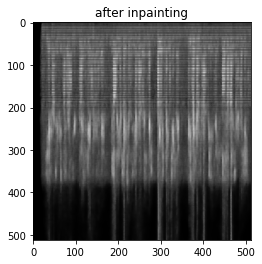


 ITERATION 5 - FILE 5...


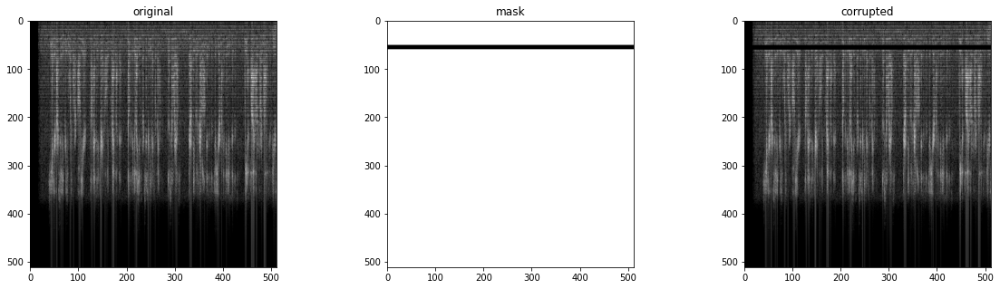

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 5 OUTPUT:



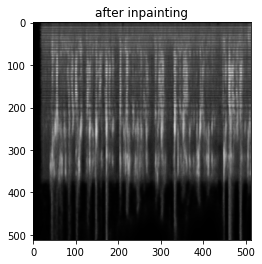


 ITERATION 5 - FILE 6...


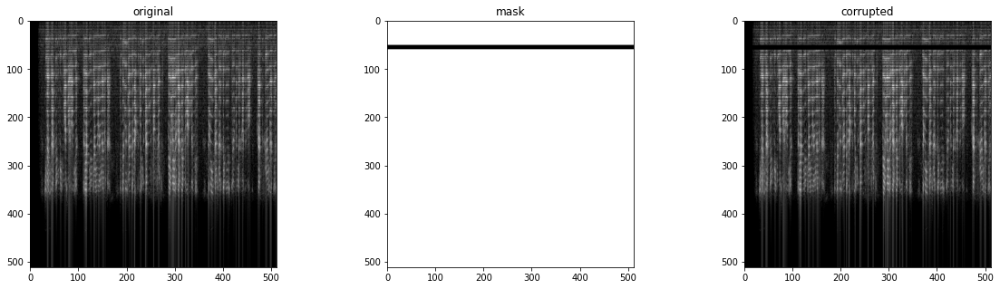

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 6 OUTPUT:



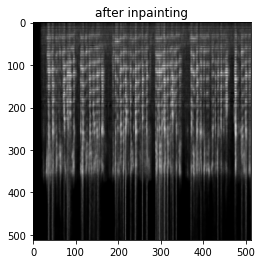


 ITERATION 5 - FILE 7...


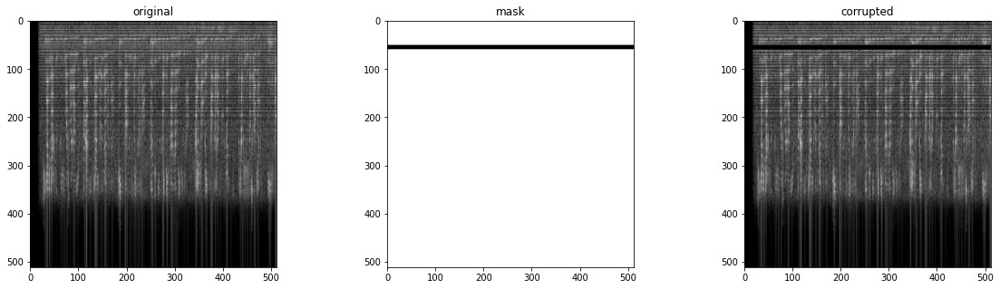

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 7 OUTPUT:



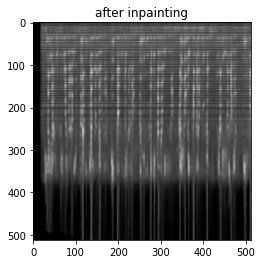


 ITERATION 5 - FILE 8...


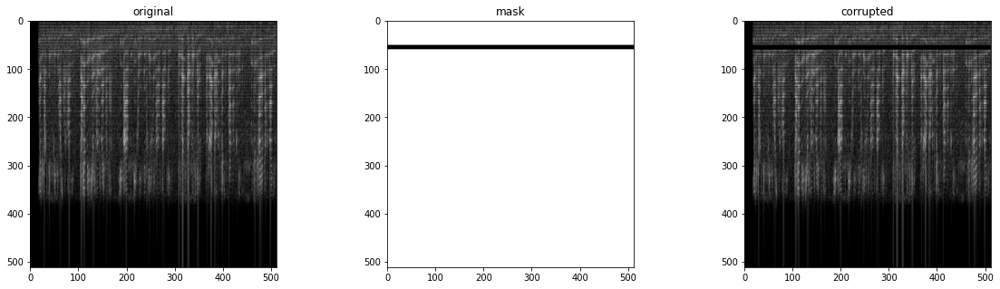

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 8 OUTPUT:



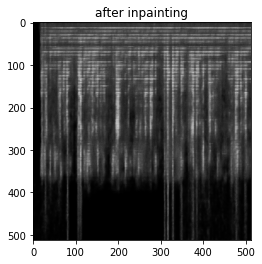


 ITERATION 5 - FILE 9...


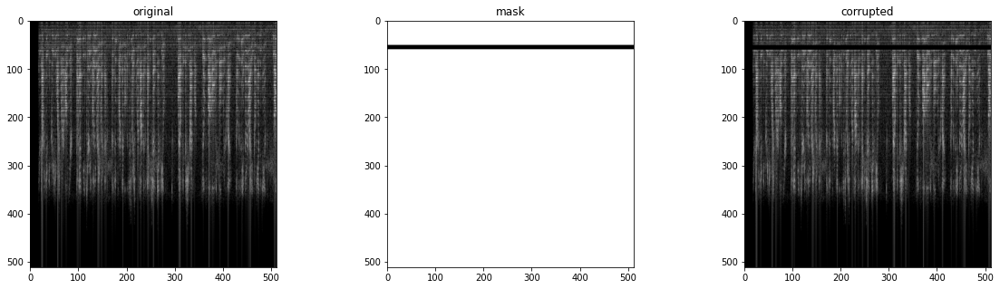

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 9 OUTPUT:



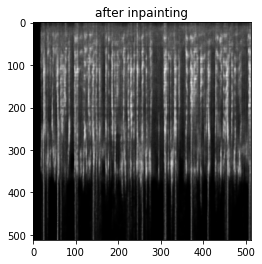


 ITERATION 5 - FILE 10...


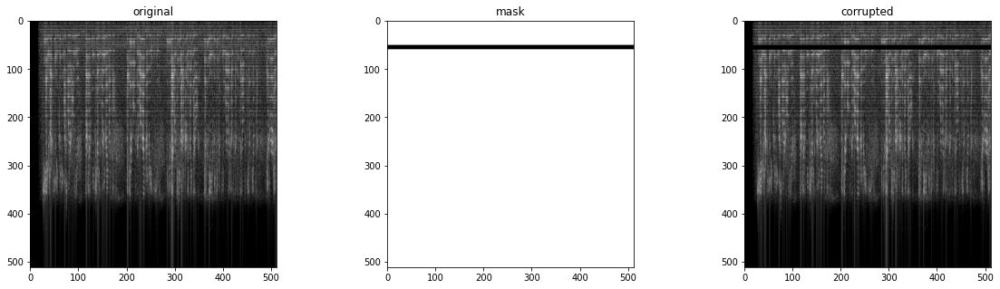

Number of params: 2962689
Starting optimization with ADAM
Iteration 186865    Loss 0.011064 
ITERATION 5 FILE 10 OUTPUT:



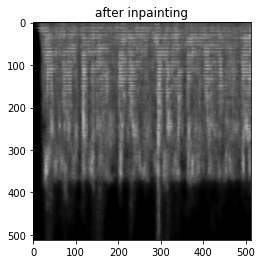


 ITERATION 5 - FILE 11...


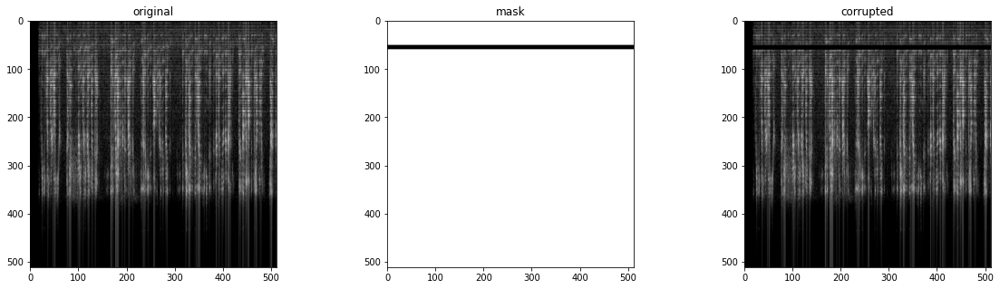

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 11 OUTPUT:



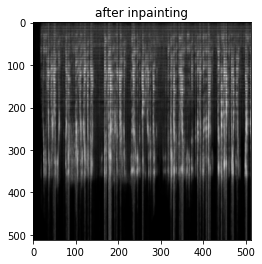


 ITERATION 5 - FILE 12...


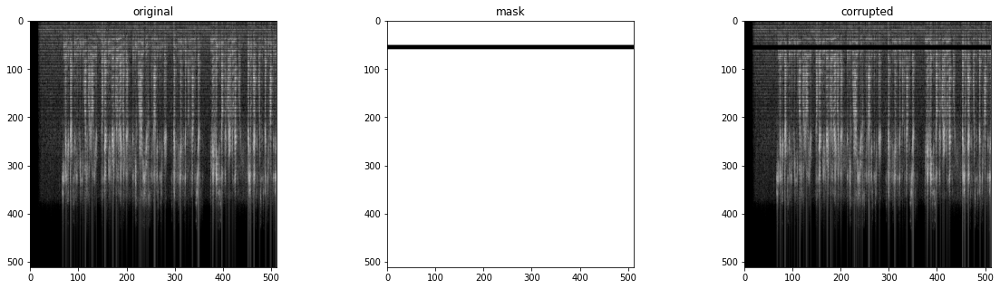

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 12 OUTPUT:



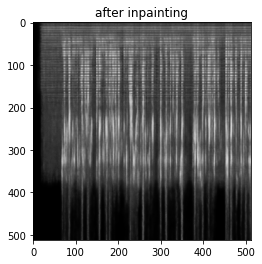


 ITERATION 5 - FILE 13...


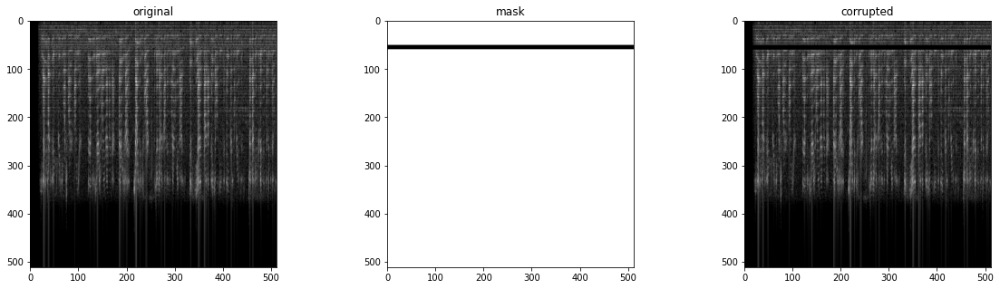

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 13 OUTPUT:



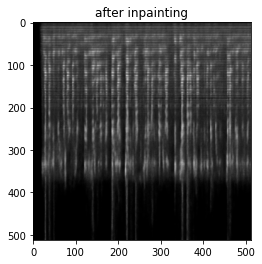


 ITERATION 5 - FILE 14...


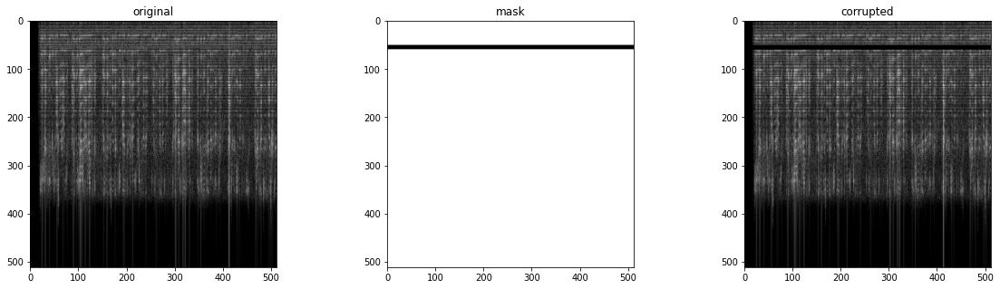

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 14 OUTPUT:



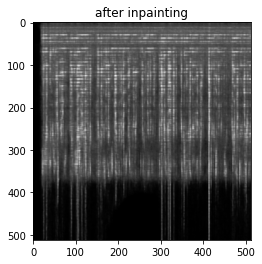


 ITERATION 5 - FILE 15...


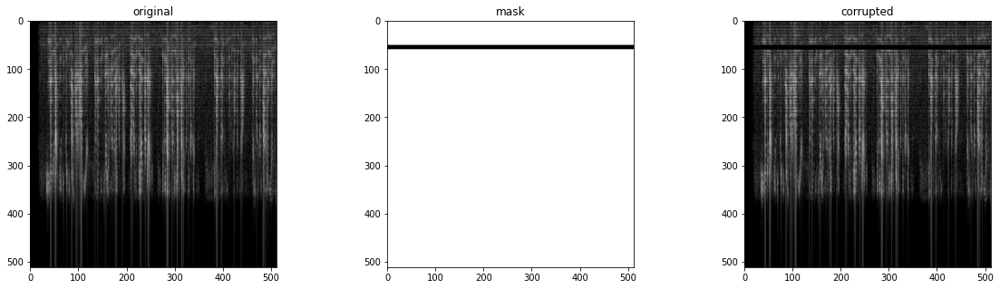

Number of params: 2962689
Starting optimization with ADAM
Iteration 188870    Loss 0.003472 
ITERATION 5 FILE 15 OUTPUT:



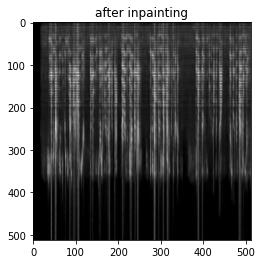


 ITERATION 5 - FILE 16...


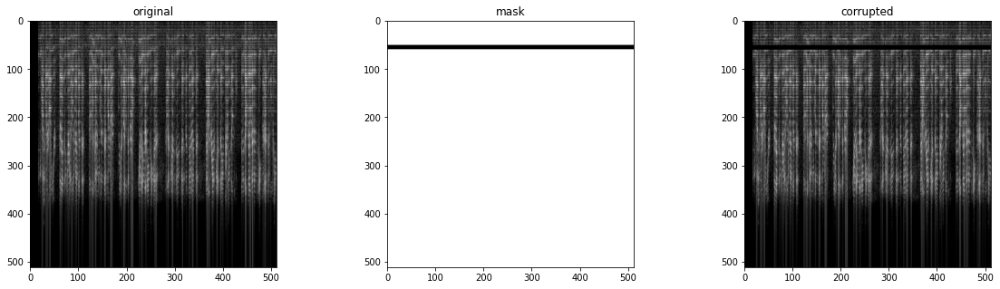

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 16 OUTPUT:



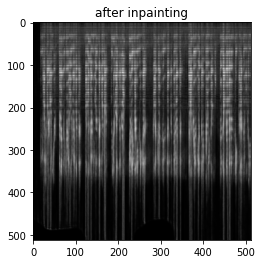


 ITERATION 5 - FILE 17...


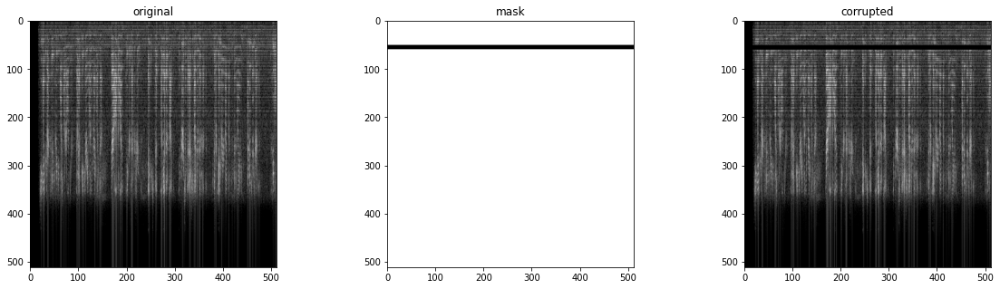

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 17 OUTPUT:



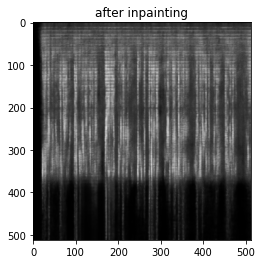


 ITERATION 5 - FILE 18...


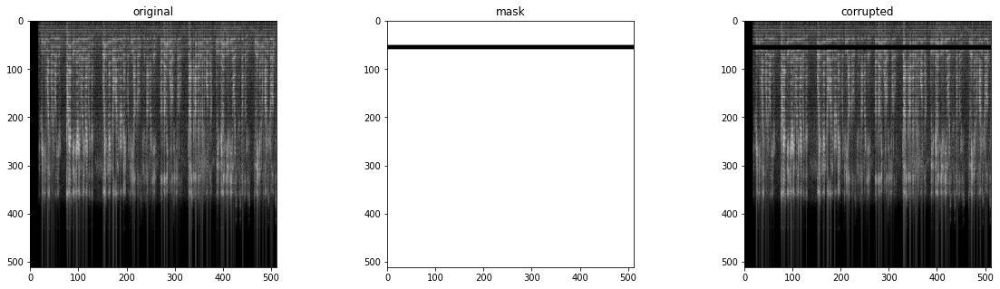

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 18 OUTPUT:



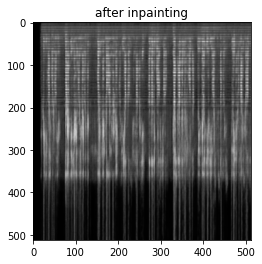


 ITERATION 5 - FILE 19...


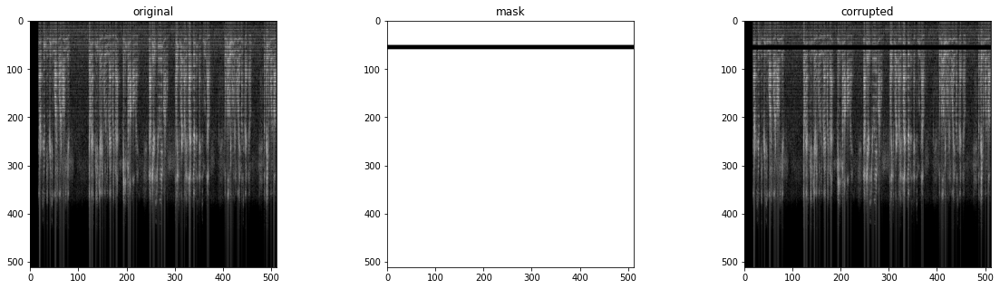

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 19 OUTPUT:



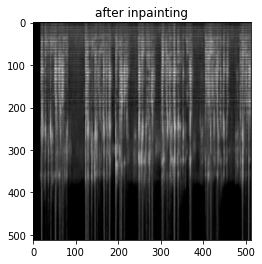


 ITERATION 5 - FILE 20...


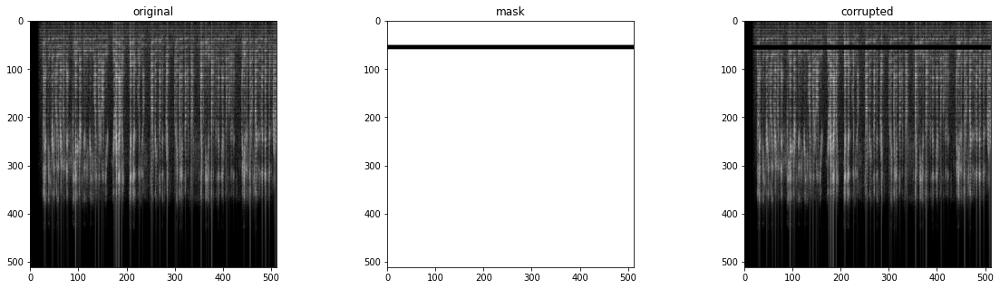

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 20 OUTPUT:



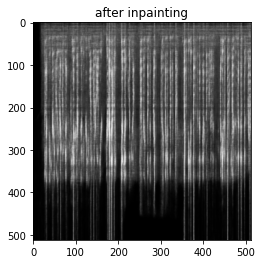


 ITERATION 5 - FILE 21...


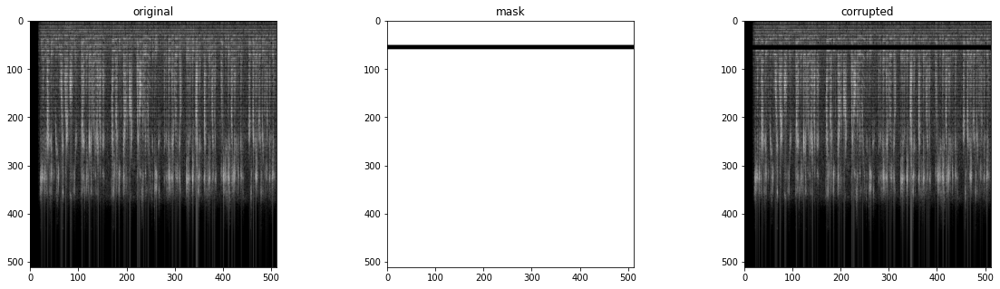

Number of params: 2962689
Starting optimization with ADAM
Iteration 191276    Loss 0.005917 
ITERATION 5 FILE 21 OUTPUT:



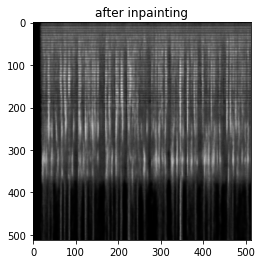


 ITERATION 5 - FILE 22...


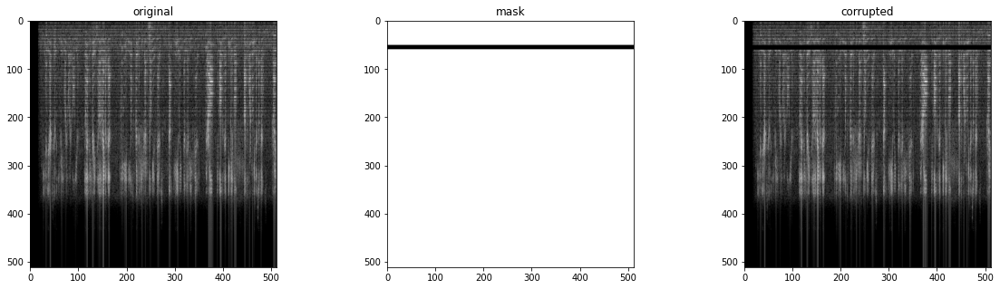

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 22 OUTPUT:



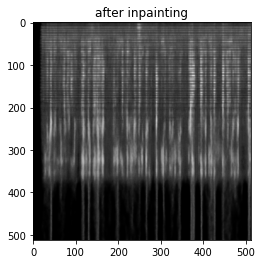


 ITERATION 5 - FILE 23...


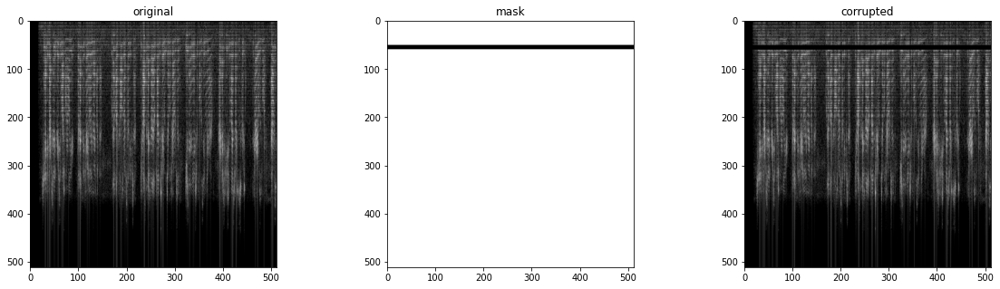

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 23 OUTPUT:



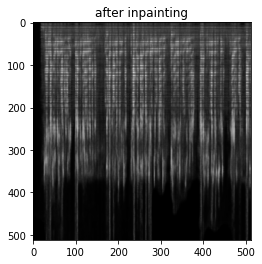


 ITERATION 5 - FILE 24...


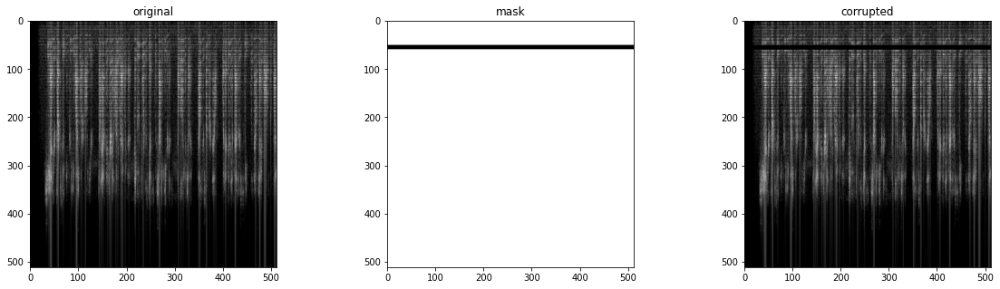

Number of params: 2962689
Starting optimization with ADAM

ITERATION 5 FILE 24 OUTPUT:



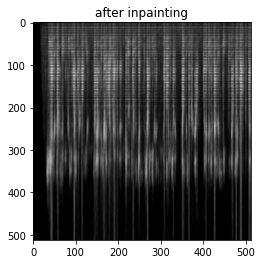

In [ ]:
from skimage.metrics import structural_similarity as ssim
from pesq import pesq

n_files = 24 # inside test folder
i = 1 # index of output file (progressive)
starting_point=50 # where to start mask
increment = 2 # increment given to the row/column corruption

# ask input parameters
data = input("1-STFT / 2-LOG MEL SPECT\n")
reconstruction = input("1-Original Phase / 2-Griffinlim\n")
while (data != "1" and data != "2") or (reconstruction != "1" and reconstruction != "2"):
    data = input("1-STFT / 2-LOG MEL SPECT\n")
    reconstruction = input("1-Original Phase / 2-Griffinlim\n")

for m in range(0, 10, increment):
  i = 1
  iteration = round(m/increment)+1
  # delete old csv if present
  if os.path.isfile('deep_prior_results_'+str(data)+'_'+str(reconstruction)+'_'+str(iteration)+'.csv'):
    os.remove('deep_prior_results_'+str(data)+'_'+str(reconstruction)+'_'+str(iteration)+'.csv')
  # creating csv file where to save results (SNR/PSNR)
  with open('deep_prior_results_'+str(data)+'_'+str(reconstruction)+'_'+str(iteration)+'.csv', mode='w') as deep_prior: # OPENING FILE (TILL THE END)
    deep_prior_writer = csv.writer(deep_prior, delimiter=',', quotechar='"', quoting=csv.QUOTE_MINIMAL)
    deep_prior_writer.writerow(['FILE', 'SNR', 'PSNR', 'SSIM', 'PESQ'])
    #so, for example...model_based_results_1_1.csv means results of data = 1 (stft) and reconstruction = 1 (original phase)
    for audio in sorted(os.listdir(test_folder)):
      ext = os.path.splitext(audio)[-1].lower()
      if ext == ".wav":
        y, sr = librosa.load(test_folder+audio, sr=16000)
        y = y[0:20*sr]
        if data == "1":
          freq_rep = librosa.stft(y, n_fft=1023, win_length=625, hop_length=625, window='rect')
          ph = np.angle(freq_rep)
        else:
          freq_rep = librosa.stft(y, n_fft=1023, win_length=625, hop_length=625, window='rect')
          ph = np.angle(freq_rep)
          freq_rep = librosa.feature.melspectrogram(S=abs(freq_rep), n_mels=512, sr=16000, power=1.0)
          
          # EVERY COLUMN IS 39ms
          # EVERY ROW IS 39Hz

          #freq_rep=freq_rep[:,:512]
        if data == "1":
            mag_db = librosa.amplitude_to_db(np.abs(freq_rep))
        else:
            mag_db = librosa.amplitude_to_db(freq_rep)  # mel
          
          # max and min values (in db) for conversion
        max_val = np.max(np.max(mag_db))
        min_val = np.min(np.min(mag_db))
        # converting into image
        freq_rep_img = np.round(((mag_db-min_val)/(max_val-min_val))*(255-0)+0)

        #creating mask image
        mask = np.ones([len(freq_rep_img), len(freq_rep_img[0])])
        mask[starting_point:(starting_point+m+1), :] = 0

        mask = mask * 255

        #saving images with PIL
        original_image = Image.fromarray(freq_rep_img.astype(np.uint8))
        original_image.save("original_image.png")
        original_image = Image.fromarray(mask.astype(np.uint8))
        original_image.save("mask_image.png")


        ## Frequency Representation Image
        img_path = 'original_image.png'
        mask_path = 'mask_image.png'

        NET_TYPE = 'skip_depth6' # one of skip_depth4|skip_depth2|UNET|ResNet

        #load mask
        img_pil, img_np = get_image(img_path, imsize)
        img_mask_pil, img_mask_np = get_image(mask_path, imsize)

        #center crop
        img_mask_pil = crop_image(img_mask_pil, dim_div_by)
        img_pil      = crop_image(img_pil,      dim_div_by)

        img_np      = pil_to_np(img_pil)
        img_mask_np = pil_to_np(img_mask_pil)

        #visualize
        img_mask_var = np_to_torch(img_mask_np).type(dtype)
        #plot_image_grid([img_np, img_mask_np, img_mask_np*img_np], 3,11);
        print("\n ITERATION "+str(iteration)+" - FILE "+str(i)+"...")
        plt.subplots(1,3,figsize=(20,5))
        plt.subplot(1, 3, 1)
        plt.imshow(img_np[0,:,:], cmap='gray')
        plt.title('original')
        plt.subplot(1, 3, 2)
        plt.imshow(img_mask_np[0,:,:], cmap='gray')
        plt.title('mask')
        plt.subplot(1, 3, 3)
        plt.imshow((img_mask_np*img_np)[0,:,:], cmap='gray')
        plt.title('corrupted')
        plt.show()

        #setup
        pad = 'reflection' # 'zero'
        OPT_OVER = 'net'
        OPTIMIZER = 'adam'

        #net
        # need to look better at this on the original notebook...

        INPUT = 'noise'
        input_depth = 1
        LR = 0.01 
        num_iter = 401 # original was 6001
        param_noise = False
        show_every = 200
        figsize = 5
        reg_noise_std = 0.03
            
        net = skip(input_depth, img_np.shape[0], 
        num_channels_down = [128] * 5,
        num_channels_up =   [128] * 5,
        num_channels_skip =    [128] * 5,  
        filter_size_up = 3, filter_size_down = 3, 
        upsample_mode='nearest', filter_skip_size=1,
        need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)

        net = net.type(dtype)
        net_input = get_noise(input_depth, INPUT, img_np.shape[1:]).type(dtype)

        # Compute number of parameters
        s  = sum(np.prod(list(p.size())) for p in net.parameters())
        print ('Number of params: %d' % s)

        # Loss
        mse = torch.nn.MSELoss().type(dtype)

        img_var = np_to_torch(img_np).type(dtype)
        mask_var = np_to_torch(img_mask_np).type(dtype)


        #execute
        net_input_saved = net_input.detach().clone()
        noise = net_input.detach().clone()

        p = get_params(OPT_OVER, net, net_input)
        optimize(OPTIMIZER, p, closure, LR, num_iter)

        #output image
        out_np = torch_to_np(net(net_input))
        #plot_image_grid([out_np], factor=5);
        print("\nITERATION "+str(iteration)+" FILE "+str(i)+" OUTPUT:\n")
        plt.figure()
        plt.imshow(out_np[0,:,:] ,cmap='gray')
        plt.title('after inpainting')
        plt.show()

        #go back to audio
        min_val_out = np.min(np.min(out_np[0,:,:]))
        max_val_out = np.max(np.max(out_np[0,:,:]))
        out_255 = ((out_np[0,:,:]-min_val_out)/(max_val_out-min_val_out))*(255-0)+0
        min_val_in = np.min(np.min(img_np[0,:,:]))
        max_val_in = np.max(np.max(img_np[0,:,:]))
        img_255 = ((img_np[0,:,:]-min_val_in)/(max_val_in-min_val_in))*(255-0)+0
        output = convert(out_255, ph, data, reconstruction, max_val, min_val, sr)
        min_out = np.min(output)
        max_out = np.max(output)

        output=((output-min_out)/(max_out-min_out))*(max(y)-min(y))+min(y) # converting back

        # writing output
        wavfile.write('output_'+str(i)+'_'+str(iteration)+'.wav', sr, output.astype(np.float32))

        # SNR and PSNR
        psnr = PSNR(img_255, out_255)
        o, sr = librosa.load('output_'+str(i)+'_'+str(iteration)+'.wav')
        snr = alternative_SNR(o)

        #PESQ
        psq = pesq(16000, y, o, 'wb')

        #SSIM
        images_ssim = ssim(img_255, out_255, data_range=img_255.max() - out_255.min())
        
        # save results in csv
        deep_prior_writer.writerow([os.path.basename(str(audio)), str(snr), str(psnr), str(images_ssim), str(psq)])

        i = i + 1


  # download csv
  #files.download('deep_prior_results_'+str(data)+'_'+str(reconstruction)+'_'+str(iteration)+'.csv')